##Setup and Install Dependencies

In [1]:
# Import libraries
import tensorflow as tf
import pandas as pd
from tensorflow.keras import layers, models
from tensorflow.keras.applications import MobileNetV2
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import seaborn as sns
import seaborn as sns
import numpy as np
import os
import zipfile
import shutil
import random
import json

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Dataset Setup

In [3]:
!curl -L -o master.zip https://www.kaggle.com/api/v1/datasets/download/ankurpaul52/balanced-multi-crop-plant-disease-dataset
!unzip -q  master.zip

src = '/content/datasets'
dest = '/content/plant_dataset'

os.makedirs(dest, exist_ok=True)

# Flatten the dataset
for crop in os.listdir(src):  # Tomato, Potato, etc.
  class_path = os.path.join(src, crop)
  if not os.path.isdir(class_path):
      continue
  for disease_class in os.listdir(class_path):
      src_path = os.path.join(class_path, disease_class)
      dest_path = os.path.join(dest, disease_class)
      if os.path.exists(src_path):
          shutil.move(src_path, dest_path)

# cleanup
# clean up
!rm -rf downloaded_dataset/
!rm -rf master.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
100 1111M  100 1111M    0     0  37.5M      0  0:00:29  0:00:29 --:--:-- 40.5M


## Data Preparation and Exploration
 Split dataset into train/val/test folders

In [4]:
def split_dataset(source_dir, dest_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):

    # Ensure ratios sum to 1
    assert abs(train_ratio + val_ratio + test_ratio - 1.0) < 0.01, "Ratios must sum to 1"

    # Create destination directories
    train_dir = os.path.join(dest_dir, 'train')
    val_dir = os.path.join(dest_dir, 'val')
    test_dir = os.path.join(dest_dir, 'test')

    # Create directories if they don't exist
    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)

    # Get all class folders (disease types)
    class_folders = [f for f in os.listdir(source_dir)
                    if os.path.isdir(os.path.join(source_dir, f))]

    print(f"Found {len(class_folders)} classes: {class_folders}")

    # Process each class separately
    for class_name in class_folders:
        class_path = os.path.join(source_dir, class_name)

        # Create class folders in train/val/test
        os.makedirs(os.path.join(train_dir, class_name), exist_ok=True)
        os.makedirs(os.path.join(val_dir, class_name), exist_ok=True)
        os.makedirs(os.path.join(test_dir, class_name), exist_ok=True)

        # Get all image files for this class
        image_files = [f for f in os.listdir(class_path)
                      if f.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]

        # Shuffle the files
        random.shuffle(image_files)

        # Calculate split pointsr
        n_total = len(image_files)
        n_train = int(n_total * train_ratio)
        n_val = int(n_total * val_ratio)
        n_test = n_total - n_train - n_val  # Remainder goes to test

        print(f"\nClass '{class_name}': {n_total} images")
        print(f"  Train: {n_train}, Val: {n_val}, Test: {n_test}")

        # Split the files
        train_files = image_files[:n_train]
        val_files = image_files[n_train:n_train + n_val]
        test_files = image_files[n_train + n_val:]

        # Copy files to respective folders
        for file_name in train_files:
            src = os.path.join(class_path, file_name)
            dst = os.path.join(train_dir, class_name, file_name)
            shutil.copy2(src, dst)

        for file_name in val_files:
            src = os.path.join(class_path, file_name)
            dst = os.path.join(val_dir, class_name, file_name)
            shutil.copy2(src, dst)

        for file_name in test_files:
            src = os.path.join(class_path, file_name)
            dst = os.path.join(test_dir, class_name, file_name)
            shutil.copy2(src, dst)

    print(f"\nDataset split completed!")
    print(f"Organized data saved to: {dest_dir}")




In [5]:
# Define dataset paths - adjust these based on your dataset structure
BASE_DIR = '/content/plant_dataset'
CORN_DIR = os.path.join('data')
split_dataset(BASE_DIR, CORN_DIR, train_ratio=0.8, val_ratio=0.1, test_ratio=0.1)

Found 28 classes: ['Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Peanut__rust', 'Grape___healthy', 'Grape___Leaf_blight', 'Corn__Gray_Leaf_Spot', 'Tomato___Septoria_leaf_spot', 'Tomato___healthy', 'Tomato___Late_blight', 'Corn__Common_Rust', 'Mango__Gall_Midge', 'Mango__Healthy', 'Tomato___Leaf_Mold', 'Grape___Esca', 'Corn__Healthy', 'Peanut__early_rust', 'Tomato___Target_Spot', 'Tomato___Early_blight', 'Tomato___Bacterial_spot', 'Peanut__nutrition_deficiency', 'Grape___Black_rot', 'Peanut__early_leaf_spot', 'Corn__Blight', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Mango__Powdery_Mildew', 'Peanut__late_leaf_spot', 'Peanut__healthy_leaf', 'Mango__Sooty_Mould', 'Tomato___Tomato_mosaic_virus']

Class 'Tomato___Tomato_Yellow_Leaf_Curl_Virus': 1200 images
  Train: 960, Val: 120, Test: 120

Class 'Peanut__rust': 1200 images
  Train: 960, Val: 120, Test: 120

Class 'Grape___healthy': 1200 images
  Train: 960, Val: 120, Test: 120

Class 'Grape___Leaf_blight': 1200 images
  Train: 960, Val

## Data Preprocessing and Augmentation

Augmentation should be handled based on the availability of data. If you have limited data (say a few hundred images) then aggressive augmentation can result in inefficient training. Because in that case the the images will become too different for model to learn patterns. In such a case go with low augmentation.
This method does not increase the number of images.

In [6]:
# Configuration
PLANT_NAME = 'All'
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
VALIDATION_SPLIT = 0.2
RANDOM_SEED = 42

# Set random seeds
tf.random.set_seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)

BASE_DIR = '/content/data'
TRAIN_DIR = os.path.join(BASE_DIR, 'train')
VAL_DIR = os.path.join(BASE_DIR, 'val')
TEST_DIR = os.path.join(BASE_DIR, 'test')

# Data augmentation for training
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.3,
    height_shift_range=0.3,
    brightness_range=[0.5, 1.5],
    shear_range=0.2,
    zoom_range=0.3,
    channel_shift_range=0.2,
    fill_mode='reflect',
    horizontal_flip=True,

)
val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

# Create data generators
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True,
    seed=RANDOM_SEED
)

validation_generator = val_datagen.flow_from_directory(
    VAL_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False,
    seed=RANDOM_SEED
)

test_generator = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False,
    seed=RANDOM_SEED
)


Found 26879 images belonging to 28 classes.
Found 3359 images belonging to 28 classes.
Found 3362 images belonging to 28 classes.


In [7]:
# Get class information
num_classes = len(train_generator.class_indices)
class_names = list(train_generator.class_indices.keys())

print(f"Number of classes: {num_classes}")
print(f"Class names: {class_names}")

Number of classes: 28
Class names: ['Corn__Blight', 'Corn__Common_Rust', 'Corn__Gray_Leaf_Spot', 'Corn__Healthy', 'Grape___Black_rot', 'Grape___Esca', 'Grape___Leaf_blight', 'Grape___healthy', 'Mango__Gall_Midge', 'Mango__Healthy', 'Mango__Powdery_Mildew', 'Mango__Sooty_Mould', 'Peanut__early_leaf_spot', 'Peanut__early_rust', 'Peanut__healthy_leaf', 'Peanut__late_leaf_spot', 'Peanut__nutrition_deficiency', 'Peanut__rust', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']


## Visualize Sample Images

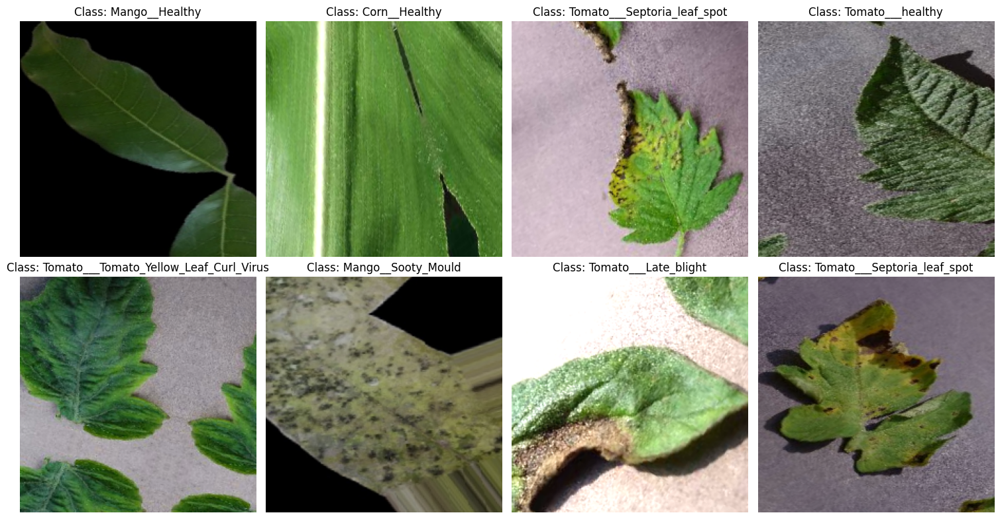

In [ ]:
def plot_sample_images(generator, class_names, num_images=8):
    fig, axes = plt.subplots(2, 4, figsize=(15, 8))
    axes = axes.ravel()

    # Get a batch of images
    images, labels = next(generator)

    for i in range(min(num_images, len(images))):
        img = images[i]
        label_idx = np.argmax(labels[i])
        class_name = class_names[label_idx]

        axes[i].imshow(img)
        axes[i].set_title(f'Class: {class_name}')
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Display sample images
plot_sample_images(train_generator, class_names)

##  Build MobileNetV2 Model

1. **Feature extractor (MobileNetV2)** - recognizes patterns
2. **Classifier head** - makes final disease prediction

This version keeps the base model in inference mode during fine-tuning, similar to the Keras [Xception example](https://keras.io/guides/transfer_learning/). This is an easy pitfall which can often go unnoticed. The BatchNormalization layers should be kept frozen (Non trainable) even if the base model (In this case MobileNetV2) is being fine tuned otherwise the accuracy can drop drastically in the first epoch of fine tune.

In [ ]:
def create_mobilenet_model(num_classes, img_size=(224, 224, 3)):

    # Load pre-trained MobileNetV2 (without top layer)
    base_model = MobileNetV2(
        input_shape=img_size,
        include_top=False,
        weights='imagenet',
        alpha=1.0  # Width multiplier
    )

    # Freeze base model initially
    base_model.trainable = False

    # Create model using Functional API to control training mode
    from tensorflow.keras import Input, Model
    inputs = Input(shape=img_size)

    x = base_model(inputs, training=False)
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(128, activation='relu')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.2)(x)
    outputs = layers.Dense(num_classes, activation='softmax')(x)

    model = Model(inputs, outputs)

    return model, base_model

In [ ]:
# Create the model
model, base_model = create_mobilenet_model(num_classes)
model.summary()

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 28)             │         3,612 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,426,076 (9.25 MB)

 Trainable params: 167,836 (655.61 KB)

 Non-trainable params: 2,258,240 (8.61 MB)

##  Model Compilation and Callbacks

In [ ]:
print(f"Trainable layers: {sum(1 for layer in base_model.layers if layer.trainable)}")

Trainable layers: 0


In [ ]:
callbacks = [
    # Save best model based on validation accuracy
    ModelCheckpoint(
        '/content/drive/MyDrive/models/plant_disease_mnv2_best_model.keras',
        monitor='val_accuracy',
        save_best_only=True,
        mode='max'
    ),

    # Stop training if no improvement
    EarlyStopping(
        monitor='val_accuracy',
        patience=7,
        restore_best_weights=True
    ),

    # Reduce learning rate when stuck
    ReduceLROnPlateau(
        monitor='val_accuracy',
        factor=0.5,
        patience=3,
        min_lr=1e-6
    )
]

In [ ]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

## Initial Training (Feature Extraction)

In [ ]:
print("Stage 1: Training classifier head (base model frozen)")
print("="*50)

# Train only the classifier head first
EPOCHS_STAGE1 = 15

history_stage1 = model.fit(
    train_generator,
    epochs=EPOCHS_STAGE1,
    validation_data=validation_generator,
    callbacks=callbacks
)

Stage 1: Training classifier head (base model frozen)


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 460s 533ms/step - accuracy: 0.6432 - loss: 1.1937 - val_accuracy: 0.8577 - val_loss: 0.4271 - learning_rate: 0.0010
Epoch 2/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 436s 519ms/step - accuracy: 0.8168 - loss: 0.5452 - val_accuracy: 0.8693 - val_loss: 0.3931 - learning_rate: 0.0010
Epoch 3/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 434s 517ms/step - accuracy: 0.8366 - loss: 0.4770 - val_accuracy: 0.8720 - val_loss: 0.3700 - learning_rate: 0.0010
Epoch 4/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 432s 514ms/step - accuracy: 0.8444 - loss: 0.4464 - val_accuracy: 0.8669 - val_loss: 0.3764 - learning_rate: 0.0010
Epoch 5/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 430s 512ms/step - accuracy: 0.8522 - loss: 0.4280 - val_accuracy: 0.8866 - val_loss: 0.3272 - learning_rate: 0.0010
Epoch 6/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 427s 508ms/step - accuracy: 0.8507 - loss: 0.4247 - val_accuracy: 0.8827 - val_loss: 0.3345 - learning_rate: 0.0010
Epoch 7/15
840/840 ━━━━━━━━━━━━━━━━━━━━ 428s 509ms/step - accura

## Fine-tuning (Unfreeze Base Model)

In [ ]:
print(len(base_model.layers))

154


In [ ]:
# Unfreeze the base model for fine-tuning
base_model.trainable = True

# Fine-tune from this layer onwards
fine_tune_at = -20

# Freeze all layers before fine_tune_at
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable = False

# Keep all BatchNormalization layers frozen
for layer in base_model.layers:
    if isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = False

# Recompile with lower learning rate for fine-tuning
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-5),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 28)             │         3,612 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,426,076 (9.25 MB)

 Trainable params: 1,362,716 (5.20 MB)

 Non-trainable params: 1,063,360 (4.06 MB)

In [ ]:
print(f"Trainable layers: {sum(1 for layer in base_model.layers if layer.trainable)}")

Trainable layers: 13


In [ ]:
print("\nStage 2: Fine-tuning model")
print("="*50)

# Continue training
EPOCHS_STAGE2 = 16

history_stage2 = model.fit(
    train_generator,
    epochs=EPOCHS_STAGE2,
    validation_data=validation_generator,
    callbacks=callbacks
)


Stage 2: Fine-tuning model
Epoch 1/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 478s 555ms/step - accuracy: 0.8783 - loss: 0.3539 - val_accuracy: 0.9116 - val_loss: 0.2598 - learning_rate: 1.0000e-05
Epoch 2/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 454s 540ms/step - accuracy: 0.8858 - loss: 0.3201 - val_accuracy: 0.9181 - val_loss: 0.2397 - learning_rate: 1.0000e-05
Epoch 3/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 498s 535ms/step - accuracy: 0.8915 - loss: 0.3143 - val_accuracy: 0.9220 - val_loss: 0.2333 - learning_rate: 1.0000e-05
Epoch 4/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 448s 533ms/step - accuracy: 0.8969 - loss: 0.2902 - val_accuracy: 0.9160 - val_loss: 0.2401 - learning_rate: 1.0000e-05
Epoch 5/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 454s 541ms/step - accuracy: 0.8963 - loss: 0.2881 - val_accuracy: 0.9205 - val_loss: 0.2278 - learning_rate: 1.0000e-05
Epoch 6/16
840/840 ━━━━━━━━━━━━━━━━━━━━ 450s 536ms/step - accuracy: 0.9069 - loss: 0.2677 - val_accuracy: 0.9211 - val_loss: 0.2239 - learning_rate: 1.0000e-05
Epoch 7/16
8

## Training Visualization

In [ ]:
def plot_training_history(history1, history2=None):

    # Combine histories
    if history2:
        acc = history1.history['accuracy'] + history2.history['accuracy']
        val_acc = history1.history['val_accuracy'] + history2.history['val_accuracy']
        loss = history1.history['loss'] + history2.history['loss']
        val_loss = history1.history['val_loss'] + history2.history['val_loss']
        epochs_range = range(len(acc))
        stage1_epochs = len(history1.history['accuracy'])
    else:
        acc = history1.history['accuracy']
        val_acc = history1.history['val_accuracy']
        loss = history1.history['loss']
        val_loss = history1.history['val_loss']
        epochs_range = range(len(acc))
        stage1_epochs = 0

    plt.figure(figsize=(12, 4))

    # Plot accuracy
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    if stage1_epochs > 0:
        plt.axvline(x=stage1_epochs-1, color='red', linestyle='--', alpha=0.7, label='Fine-tuning starts')
    plt.legend(loc='lower right')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')

    # Plot loss
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    if stage1_epochs > 0:
        plt.axvline(x=stage1_epochs-1, color='red', linestyle='--', alpha=0.7, label='Fine-tuning starts')
    plt.legend(loc='upper right')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')

    plt.tight_layout()
    plt.show()

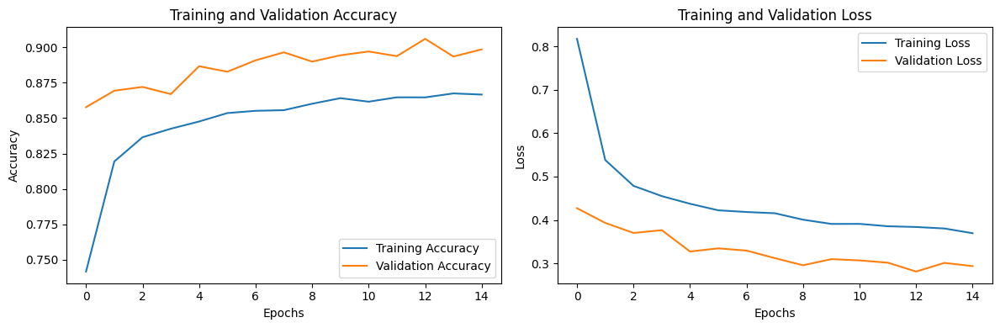

In [ ]:
# Plot training history
plot_training_history(history_stage1) # history_stage2

## Model Evaluation

In [9]:
# Load the best model
model = tf.keras.models.load_model('/content/plant_disease_mnv2_best_model.keras')

In [10]:
# Evaluate on test set
print("Final Model Evaluation:")
print("="*30)

test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Validation Loss: {test_loss:.4f}")
print(f"Validation Accuracy: {test_accuracy:.4f}")
# print(f"Validation Top-3 Accuracy: {test_top3_accuracy:.4f}")

Final Model Evaluation:


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


106/106 ━━━━━━━━━━━━━━━━━━━━ 27s 177ms/step - accuracy: 0.9448 - loss: 0.1415
Validation Loss: 0.1372
Validation Accuracy: 0.9515


In [11]:
# Generate predictions for detailed analysis
test_generator.reset()  # Reset generator
predictions = model.predict(test_generator, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get true labels
true_classes = test_generator.classes
class_labels = list(test_generator.class_indices.keys())

106/106 ━━━━━━━━━━━━━━━━━━━━ 16s 118ms/step


In [12]:
# Classification report
print("\nClassification Report:")
print("="*50)

# Get the actual class labels from the test generator
actual_class_labels = list(test_generator.class_indices.keys())

print(classification_report(true_classes, predicted_classes, target_names=actual_class_labels))


Classification Report:
                                               precision    recall  f1-score   support

                                 Corn__Blight       0.86      0.85      0.86       120
                            Corn__Common_Rust       0.99      0.93      0.96       120
                         Corn__Gray_Leaf_Spot       0.82      0.89      0.85       120
                                Corn__Healthy       1.00      1.00      1.00       120
                            Grape___Black_rot       0.99      0.99      0.99       120
                                 Grape___Esca       0.99      0.99      0.99       120
                          Grape___Leaf_blight       1.00      1.00      1.00       120
                              Grape___healthy       1.00      1.00      1.00       120
                            Mango__Gall_Midge       1.00      0.99      1.00       120
                               Mango__Healthy       1.00      1.00      1.00       120
                  

## Confusion Matrix

Label Legend:
CB: Corn__Blight
CCR: Corn__Common_Rust
CGLS: Corn__Gray_Leaf_Spot
CHLT: Corn__Healthy
GBR: Grape___Black_rot
GE: Grape___Esca
GLB: Grape___Leaf_blight
GHLT: Grape___healthy
MGM: Mango__Gall_Midge
MHLT: Mango__Healthy
MPM: Mango__Powdery_Mildew
MSM: Mango__Sooty_Mould
PELS: Peanut__early_leaf_spot
PER: Peanut__early_rust
PHLT: Peanut__healthy_leaf
PLLS: Peanut__late_leaf_spot
PND: Peanut__nutrition_deficiency
PR: Peanut__rust
TBS: Tomato___Bacterial_spot
TEB: Tomato___Early_blight
TLB: Tomato___Late_blight
TLM: Tomato___Leaf_Mold
TSLS: Tomato___Septoria_leaf_spot
TSM: Tomato___Spider_mites Two-spotted_spider_mite
TTS: Tomato___Target_Spot
TTYLCV: Tomato___Tomato_Yellow_Leaf_Curl_Virus
TTMV: Tomato___Tomato_mosaic_virus
THLT: Tomato___healthy


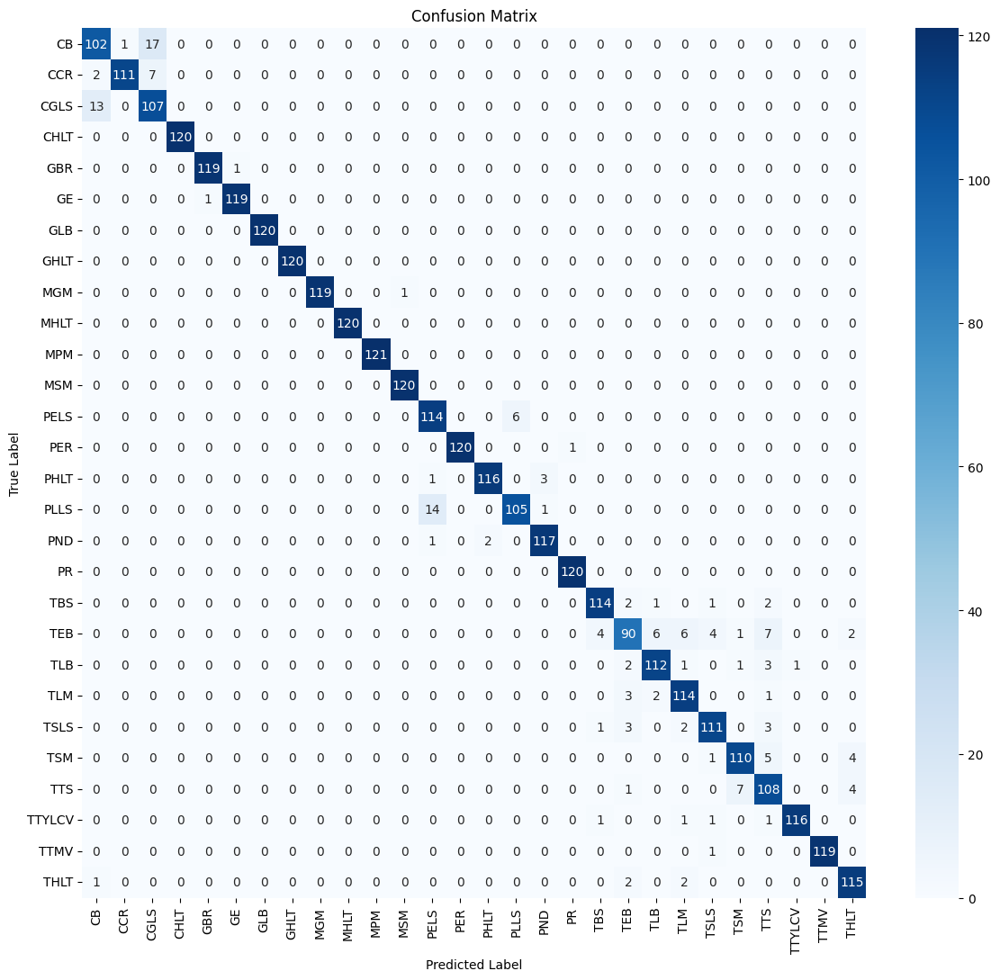

In [37]:
# Create ultra-short labels
label_mapping = {
    # Corn
    'Corn__Blight': 'CB',
    'Corn__Common_Rust': 'CCR',
    'Corn__Gray_Leaf_Spot': 'CGLS',
    'Corn__Healthy': 'CHLT',

    # Grape
    'Grape___Black_rot': 'GBR',
    'Grape___Esca': 'GE',
    'Grape___Leaf_blight': 'GLB',
    'Grape___healthy': 'GHLT',

    # Mango
    'Mango__Gall_Midge': 'MGM',
    'Mango__Healthy': 'MHLT',
    'Mango__Powdery_Mildew': 'MPM',
    'Mango__Sooty_Mould': 'MSM',

    # Peanut
    'Peanut__early_leaf_spot': 'PELS',
    'Peanut__early_rust': 'PER',
    'Peanut__healthy_leaf': 'PHLT',
    'Peanut__late_leaf_spot': 'PLLS',
    'Peanut__nutrition_deficiency': 'PND',
    'Peanut__rust': 'PR',

    # Tomato
    'Tomato___Bacterial_spot': 'TBS',
    'Tomato___Early_blight': 'TEB',
    'Tomato___Late_blight': 'TLB',
    'Tomato___Leaf_Mold': 'TLM',
    'Tomato___Septoria_leaf_spot': 'TSLS',
    'Tomato___Spider_mites Two-spotted_spider_mite': 'TSM',
    'Tomato___Target_Spot': 'TTS',
    'Tomato___Tomato_Yellow_Leaf_Curl_Virus': 'TTYLCV',
    'Tomato___Tomato_mosaic_virus': 'TTMV',
    'Tomato___healthy': 'THLT',
}

# Convert your class labels to short forms
short_labels = [label_mapping.get(label, label[:3]) for label in class_labels]

# Plot confusion matrix with short labels
plt.figure(figsize=(12, 11))
cm = confusion_matrix(true_classes, predicted_classes)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=short_labels, yticklabels=short_labels)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.tight_layout()

# Optional: Print legend for reference
print("Label Legend:")
for full, short in label_mapping.items():
    print(f"{short}: {full}")

plt.show()

## Visualize Result
Creates a visual test board displaying model predictions vs actual labels

In [34]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
from PIL import Image

def create_test_board(model, test_generator, class_names,
                     grid_size=(5, 5), figsize=(20, 20),
                     title=f"Plant Leaf Disease Detection Results\n"):
    """
    Creates a visual test board displaying model predictions vs actual labels

    Parameters:
    - model: trained model
    - test_generator: ImageDataGenerator for test data
    - class_names: List of disease class names
    - grid_size: Tuple (rows, cols) for the grid layout
    - figsize: Figure size for the display
    - title: Main title for the board
    """

    rows, cols = grid_size
    total_images = rows * cols

    # Create the figure
    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    fig.suptitle(title, fontsize=24, fontweight='bold', y=0.98)

    # Flatten axes for easier indexing
    if rows == 1 or cols == 1:
        axes = axes.flatten()
    else:
        axes = axes.flatten()

    # Get a batch of test images and their true labels
    test_batch, true_labels = next(test_generator)

    # Ensure we don't exceed available images
    num_images = min(total_images, len(test_batch))

    # Make predictions
    predictions = model.predict(test_batch[:num_images])
    predicted_classes = np.argmax(predictions, axis=1)
    true_classes = np.argmax(true_labels[:num_images], axis=1)

    for i in range(num_images):
        # Display the image
        img = test_batch[i]
        if img.shape[-1] == 1:  # Grayscale
            axes[i].imshow(img.squeeze(), cmap='gray')
        else:  # RGB
            # Normalize image if needed
            if img.max() <= 1.0:
                img_display = img
            else:
                img_display = img / 255.0
            axes[i].imshow(img_display)

        # Get class names
        true_class = class_names[true_classes[i]]
        pred_class = class_names[predicted_classes[i]]
        confidence = np.max(predictions[i]) * 100

        # Create title with actual vs predicted
        is_correct = true_classes[i] == predicted_classes[i]
        color = 'green' if is_correct else 'red'

        title_text = f"True: {true_class}\nPred: {pred_class}\nConf: {confidence:.1f}%"

        axes[i].set_title(title_text, fontsize=10, color=color,
                         fontweight='bold' if not is_correct else 'normal')
        axes[i].axis('off')

    # Hide any unused subplots
    for i in range(num_images, len(axes)):
        axes[i].axis('off')

    plt.tight_layout()
    return fig

def create_detailed_test_board(model, test_generator, class_names,
                              samples_per_class=3, figsize=(20, 15)):
    """
    Creates a more detailed test board organized by disease classes
    """

    num_classes = len(class_names)

    # Create figure with subplots arranged by class
    fig, axes = plt.subplots(num_classes, samples_per_class,
                            figsize=figsize)
    fig.suptitle(f"Plant Disease Detection - Organized by Class",
                fontsize=20, fontweight='bold')

    if num_classes == 1:
        axes = axes.reshape(1, -1)

    # Collect samples for each class
    class_samples = {i: [] for i in range(num_classes)}

    # Iterate through test data to collect samples
    for batch_imgs, batch_labels in test_generator:
        batch_true_classes = np.argmax(batch_labels, axis=1)

        for img, true_class in zip(batch_imgs, batch_true_classes):
            if len(class_samples[true_class]) < samples_per_class:
                class_samples[true_class].append(img)

        # Check if we have enough samples for all classes
        if all(len(samples) >= samples_per_class
               for samples in class_samples.values()):
            break

    # Display samples for each class
    for class_idx in range(num_classes):
        for sample_idx in range(samples_per_class):
            ax = axes[class_idx, sample_idx]

            if sample_idx < len(class_samples[class_idx]):
                img = class_samples[class_idx][sample_idx]

                # Make prediction
                img_batch = np.expand_dims(img, axis=0)
                prediction = model.predict(img_batch, verbose=0)
                pred_class_idx = np.argmax(prediction)
                confidence = np.max(prediction) * 100

                # Display image
                if img.shape[-1] == 1:
                    ax.imshow(img.squeeze(), cmap='gray')
                else:
                    display_img = img if img.max() <= 1.0 else img / 255.0
                    ax.imshow(display_img)

                # Create title
                true_class = class_names[class_idx]
                pred_class = class_names[pred_class_idx]
                is_correct = class_idx == pred_class_idx
                color = 'green' if is_correct else 'red'

                title = f"True: {true_class}\nPred: {pred_class}\nConf: {confidence:.1f}%"
                ax.set_title(title, fontsize=9, color=color)

            ax.axis('off')

    # Add class labels on the left
    for class_idx in range(num_classes):
        axes[class_idx, 0].set_ylabel(class_names[class_idx],
                                     fontsize=12, fontweight='bold')

    plt.tight_layout()
    return fig

In [15]:
test_generator = test_datagen.flow_from_directory(
    'data/test',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=True
)

Found 3362 images belonging to 28 classes.


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


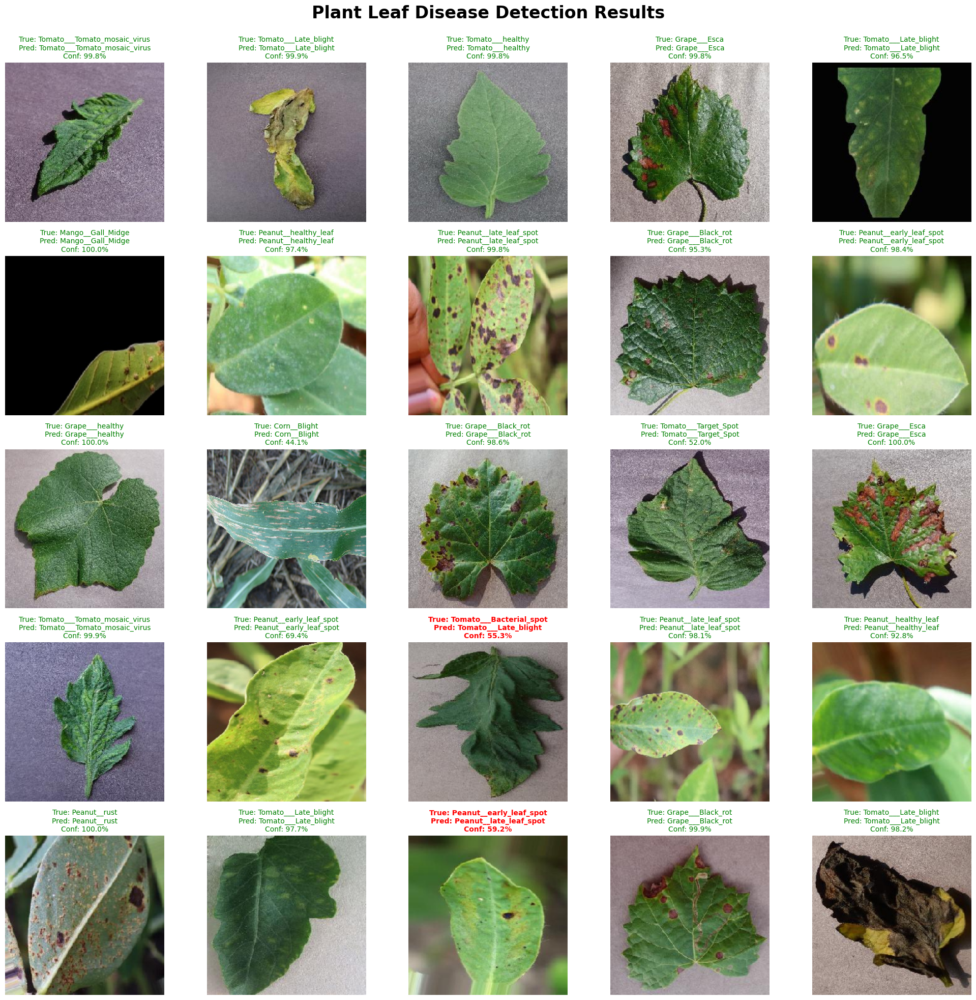

In [16]:
fig1 = create_test_board(model, test_generator, class_names, grid_size=(5, 5))
plt.savefig(f'Plant_disease_test_board_5x5.png', dpi=300, bbox_inches='tight')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


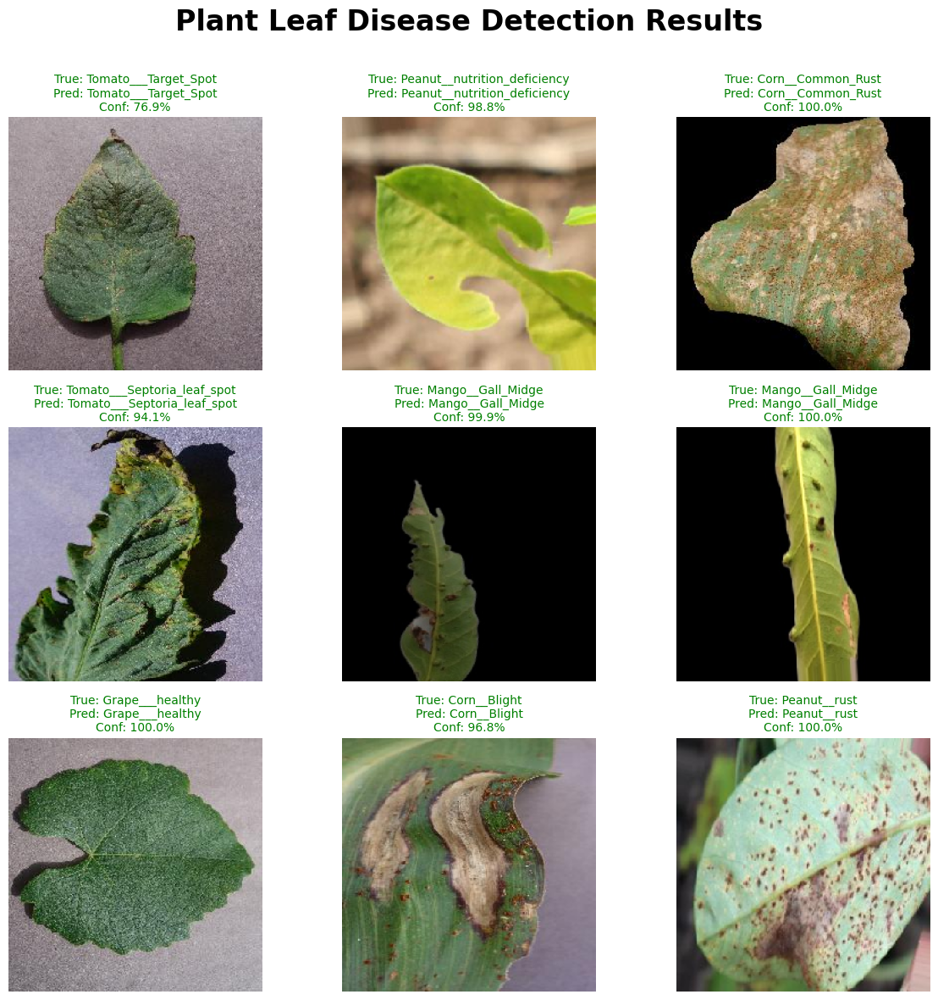

In [17]:
fig2 = create_test_board(model, test_generator, class_names, grid_size=(3, 3), figsize=(12, 12))
plt.savefig(f'Plant_disease_test_board_3x3.png', dpi=300, bbox_inches='tight')
plt.show()

🚀 Initializing Model Tester...
Loading model from /content/plant_disease_mnv2_best_model.keras
Model loaded successfully!
Model input shape: (None, 224, 224, 3)
Found classes: ['Corn__Blight', 'Corn__Common_Rust', 'Corn__Gray_Leaf_Spot', 'Corn__Healthy', 'Grape___Black_rot', 'Grape___Esca', 'Grape___Leaf_blight', 'Grape___healthy', 'Mango__Gall_Midge', 'Mango__Healthy', 'Mango__Powdery_Mildew', 'Mango__Sooty_Mould', 'Peanut__early_leaf_spot', 'Peanut__early_rust', 'Peanut__healthy_leaf', 'Peanut__late_leaf_spot', 'Peanut__nutrition_deficiency', 'Peanut__rust', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']

🎯 Model will show top 5 predictions per image
🎲 Starting random image testing...

Testing random images from class: Corn__Blight
Found 2

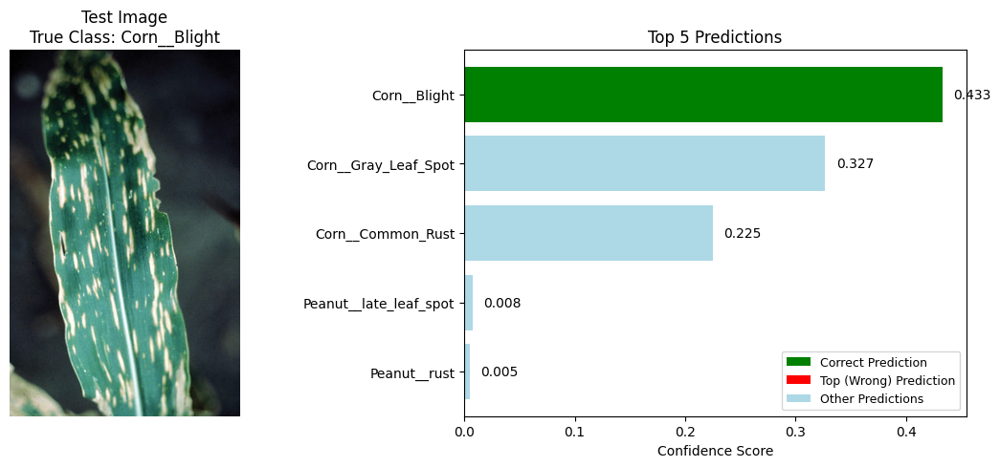

    Detailed predictions:
      1. Corn__Blight: 0.4330 ✓ (CORRECT)
      2. Corn__Gray_Leaf_Spot: 0.3270
      3. Corn__Common_Rust: 0.2250
      4. Peanut__late_leaf_spot: 0.0076
      5. Peanut__rust: 0.0049

--- Image 2/3: control-northern-corn-leaf-blight_Figure1-1024x466.jpg ---
  ✅ Predicted: Corn__Blight (confidence: 0.9721)
    True class: Corn__Blight


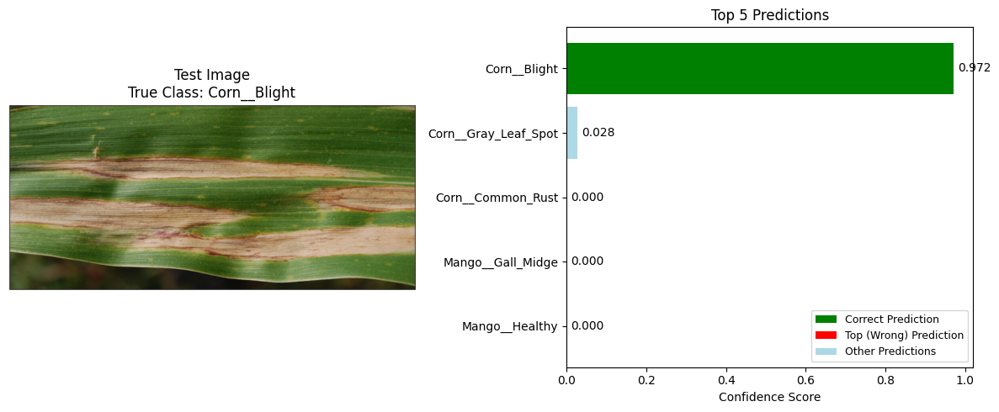

    Detailed predictions:
      1. Corn__Blight: 0.9721 ✓ (CORRECT)
      2. Corn__Gray_Leaf_Spot: 0.0277
      3. Corn__Common_Rust: 0.0002
      4. Mango__Gall_Midge: 0.0000
      5. Mango__Healthy: 0.0000

--- Image 3/3: IMG-northern-corn-leaf-blight-NA-US.jpg ---
  ✅ Predicted: Corn__Blight (confidence: 0.5422)
    True class: Corn__Blight


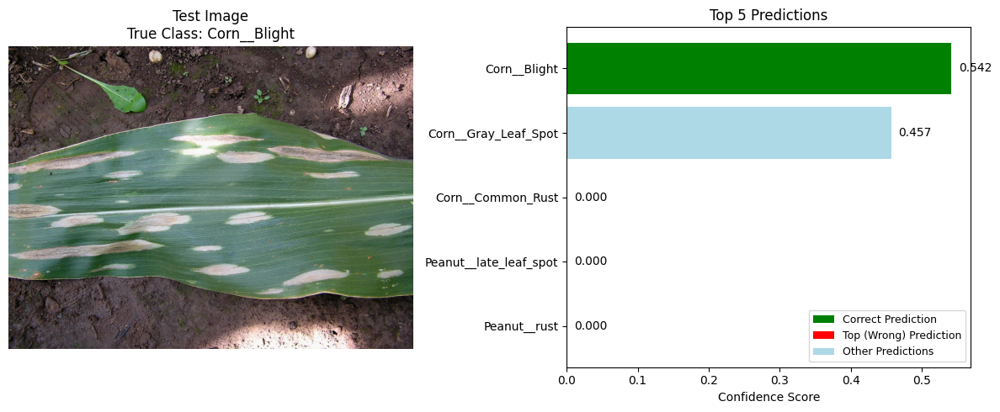

    Detailed predictions:
      1. Corn__Blight: 0.5422 ✓ (CORRECT)
      2. Corn__Gray_Leaf_Spot: 0.4574
      3. Corn__Common_Rust: 0.0004
      4. Peanut__late_leaf_spot: 0.0000
      5. Peanut__rust: 0.0000

Testing random images from class: Corn__Common_Rust
Found 11 images in Corn__Common_Rust
Randomly selected 3 images for testing

--- Image 1/3: commonrust_600px.jpg ---
  ✅ Predicted: Corn__Common_Rust (confidence: 0.9429)
    True class: Corn__Common_Rust


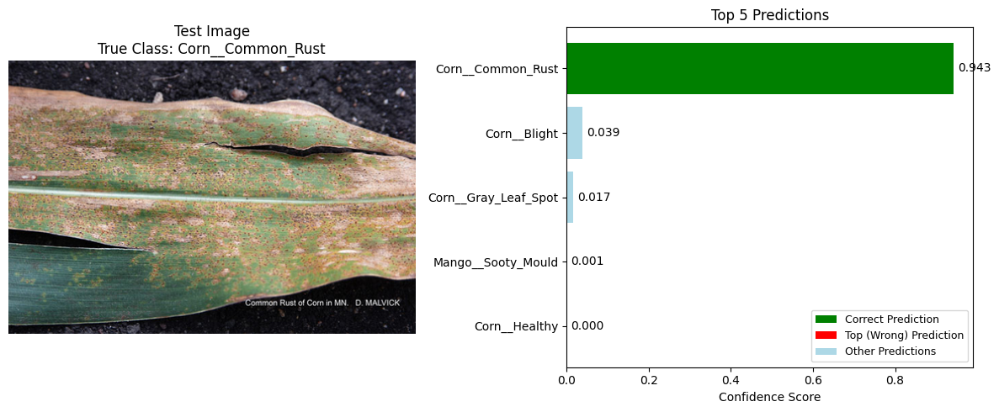

    Detailed predictions:
      1. Corn__Common_Rust: 0.9429 ✓ (CORRECT)
      2. Corn__Blight: 0.0392
      3. Corn__Gray_Leaf_Spot: 0.0172
      4. Mango__Sooty_Mould: 0.0007
      5. Corn__Healthy: 0.0000

--- Image 2/3: image (1).jpeg ---
  ❌ Predicted: Corn__Blight (confidence: 0.3492)
    True class: Corn__Common_Rust


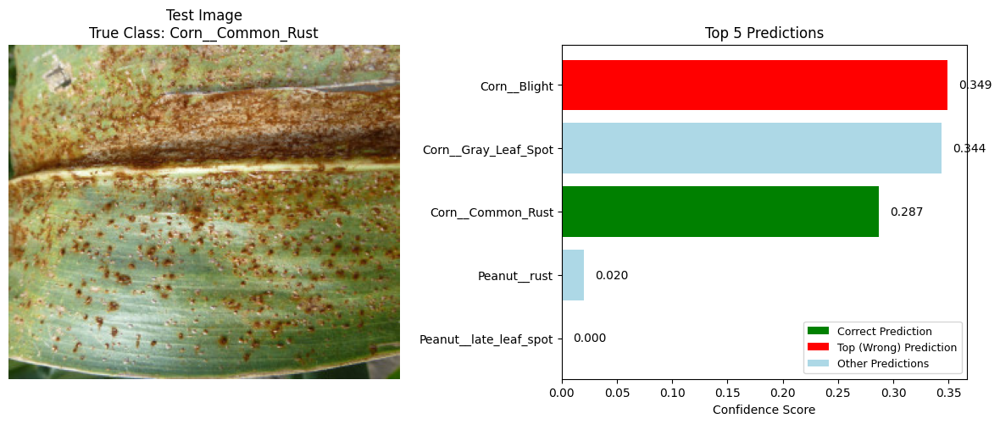

    Detailed predictions:
      1. Corn__Blight: 0.3492 ✗ (TOP PREDICTION - WRONG)
      2. Corn__Gray_Leaf_Spot: 0.3436
      3. Corn__Common_Rust: 0.2868 ✓ (CORRECT)
      4. Peanut__rust: 0.0202
      5. Peanut__late_leaf_spot: 0.0001

--- Image 3/3: 5465562-WEB.jpg ---
  ✅ Predicted: Corn__Common_Rust (confidence: 0.5739)
    True class: Corn__Common_Rust


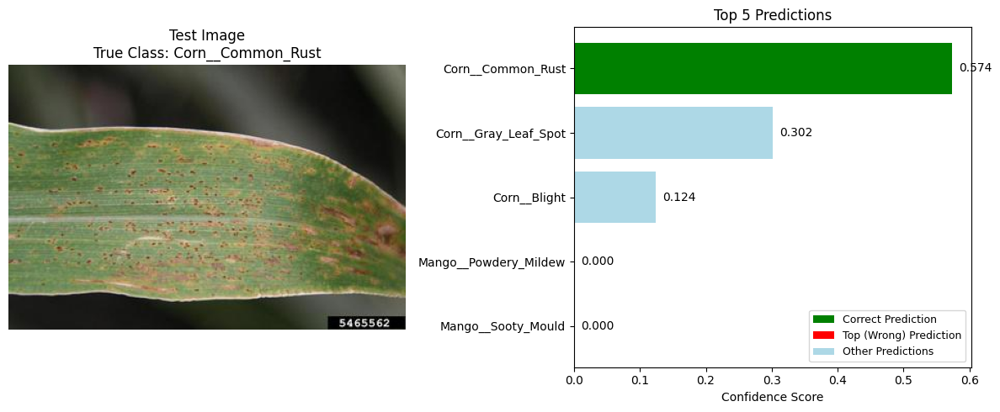

    Detailed predictions:
      1. Corn__Common_Rust: 0.5739 ✓ (CORRECT)
      2. Corn__Gray_Leaf_Spot: 0.3019
      3. Corn__Blight: 0.1241
      4. Mango__Powdery_Mildew: 0.0001
      5. Mango__Sooty_Mould: 0.0000

Testing random images from class: Grape___Black_rot
Found 3 images in Grape___Black_rot
Randomly selected 3 images for testing

--- Image 1/3: images.jpeg ---
  ✅ Predicted: Grape___Black_rot (confidence: 0.2580)
    True class: Grape___Black_rot


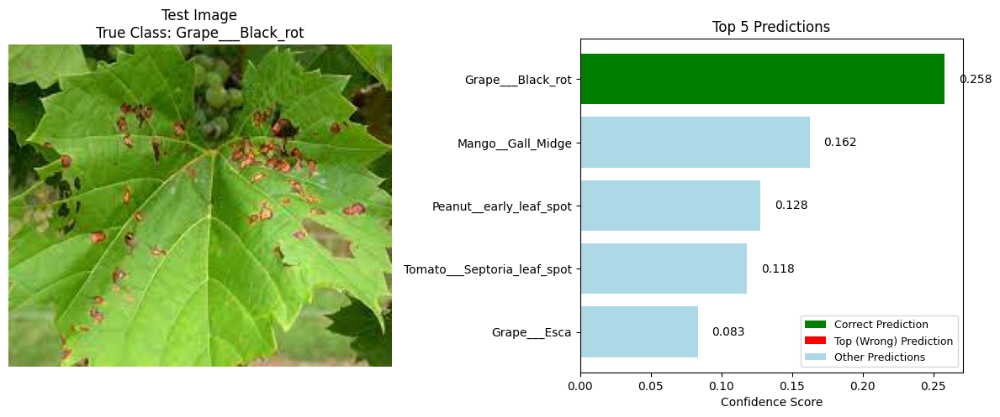

    Detailed predictions:
      1. Grape___Black_rot: 0.2580 ✓ (CORRECT)
      2. Mango__Gall_Midge: 0.1624
      3. Peanut__early_leaf_spot: 0.1277
      4. Tomato___Septoria_leaf_spot: 0.1181
      5. Grape___Esca: 0.0833

--- Image 2/3: black-rot-of-grape_figure-1.jpg ---
  ❌ Predicted: Grape___Esca (confidence: 0.4695)
    True class: Grape___Black_rot


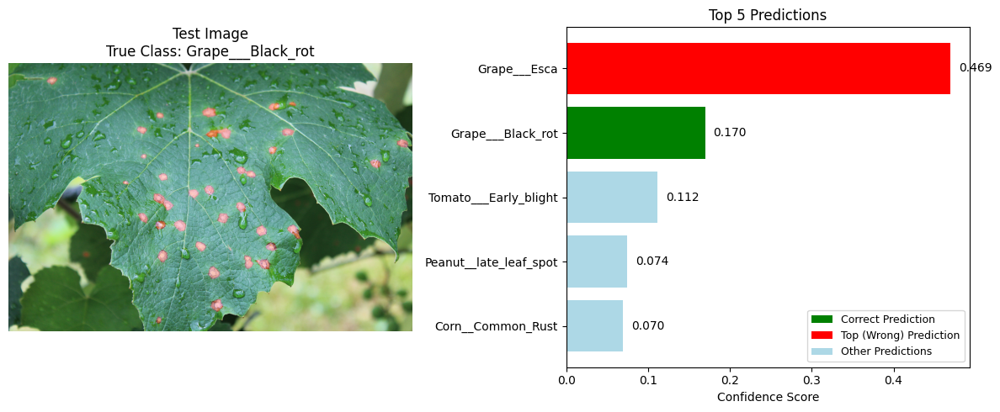

    Detailed predictions:
      1. Grape___Esca: 0.4695 ✗ (TOP PREDICTION - WRONG)
      2. Grape___Black_rot: 0.1698 ✓ (CORRECT)
      3. Tomato___Early_blight: 0.1118
      4. Peanut__late_leaf_spot: 0.0745
      5. Corn__Common_Rust: 0.0695

--- Image 3/3: fig-3a.jpg ---
  ❌ Predicted: Grape___Esca (confidence: 0.6144)
    True class: Grape___Black_rot


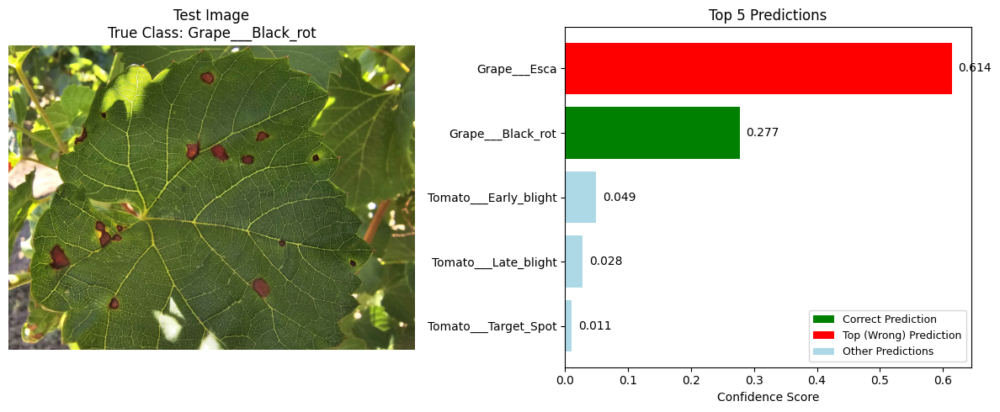

    Detailed predictions:
      1. Grape___Esca: 0.6144 ✗ (TOP PREDICTION - WRONG)
      2. Grape___Black_rot: 0.2771 ✓ (CORRECT)
      3. Tomato___Early_blight: 0.0495
      4. Tomato___Late_blight: 0.0280
      5. Tomato___Target_Spot: 0.0106

Testing random images from class: Grape___Esca
Found 1 images in Grape___Esca
Randomly selected 1 images for testing

--- Image 1/1: basf_tessior_125_1200x675.jpg ---
  ✅ Predicted: Grape___Esca (confidence: 0.6924)
    True class: Grape___Esca


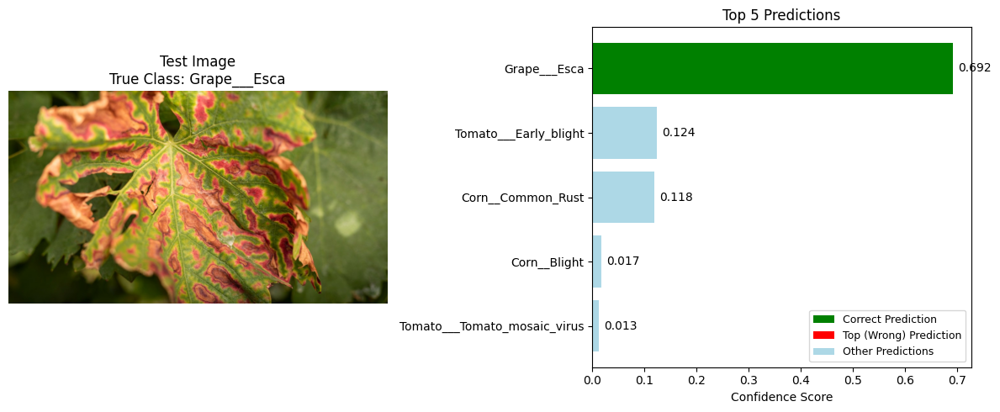

    Detailed predictions:
      1. Grape___Esca: 0.6924 ✓ (CORRECT)
      2. Tomato___Early_blight: 0.1238
      3. Corn__Common_Rust: 0.1183
      4. Corn__Blight: 0.0166
      5. Tomato___Tomato_mosaic_virus: 0.0129

Testing random images from class: Grape___Leaf_blight
Found 3 images in Grape___Leaf_blight
Randomly selected 3 images for testing

--- Image 1/3: Black_Rot_of_Grapes152.jpg ---
  ❌ Predicted: Tomato___Early_blight (confidence: 0.3718)
    True class: Grape___Leaf_blight


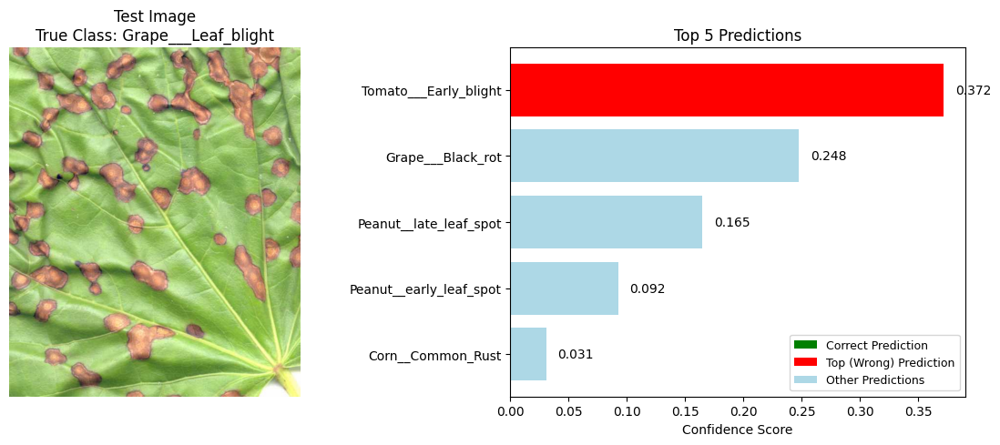

    Detailed predictions:
      1. Tomato___Early_blight: 0.3718 ✗ (TOP PREDICTION - WRONG)
      2. Grape___Black_rot: 0.2477
      3. Peanut__late_leaf_spot: 0.1646
      4. Peanut__early_leaf_spot: 0.0924
      5. Corn__Common_Rust: 0.0308

--- Image 2/3: black_rot_1.jpg ---
  ❌ Predicted: Tomato___Leaf_Mold (confidence: 0.8284)
    True class: Grape___Leaf_blight


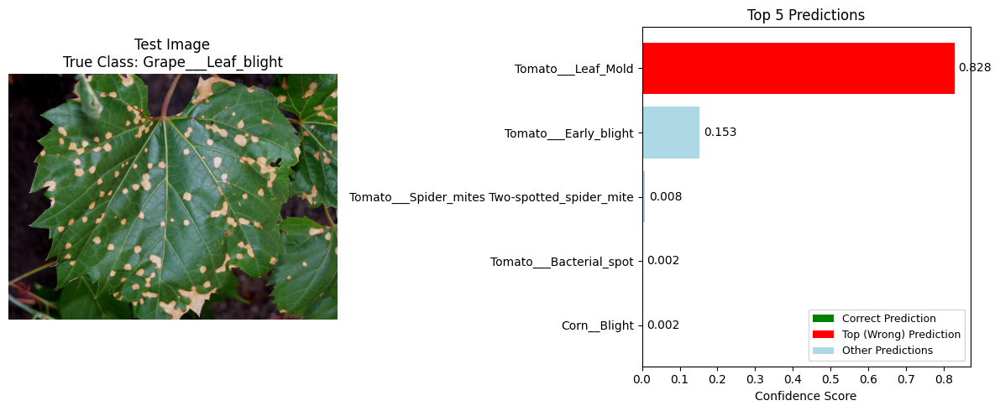

    Detailed predictions:
      1. Tomato___Leaf_Mold: 0.8284 ✗ (TOP PREDICTION - WRONG)
      2. Tomato___Early_blight: 0.1532
      3. Tomato___Spider_mites Two-spotted_spider_mite: 0.0085
      4. Tomato___Bacterial_spot: 0.0023
      5. Corn__Blight: 0.0021

--- Image 3/3: fig-3a.jpg ---
  ❌ Predicted: Grape___Esca (confidence: 0.6144)
    True class: Grape___Leaf_blight


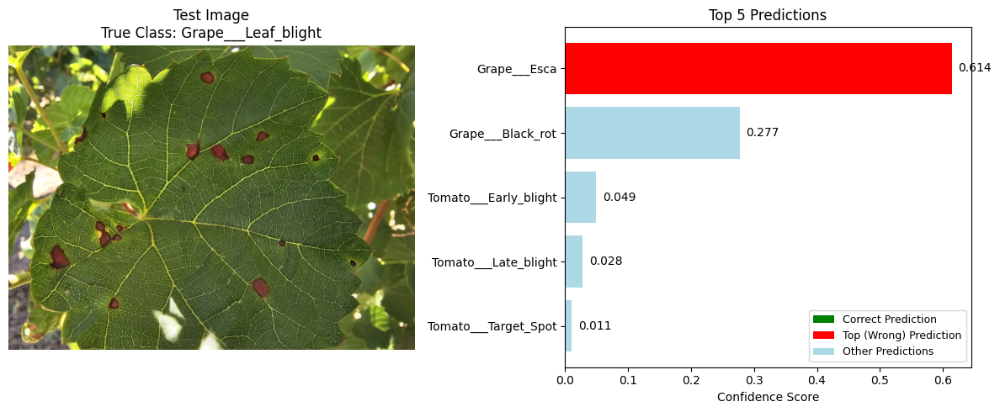

    Detailed predictions:
      1. Grape___Esca: 0.6144 ✗ (TOP PREDICTION - WRONG)
      2. Grape___Black_rot: 0.2771
      3. Tomato___Early_blight: 0.0495
      4. Tomato___Late_blight: 0.0280
      5. Tomato___Target_Spot: 0.0106

Testing random images from class: Grape___healthy
Found 2 images in Grape___healthy
Randomly selected 2 images for testing

--- Image 1/2: Grolleau_noir_leaves.jpg ---
  ❌ Predicted: Tomato___Leaf_Mold (confidence: 0.4331)
    True class: Grape___healthy


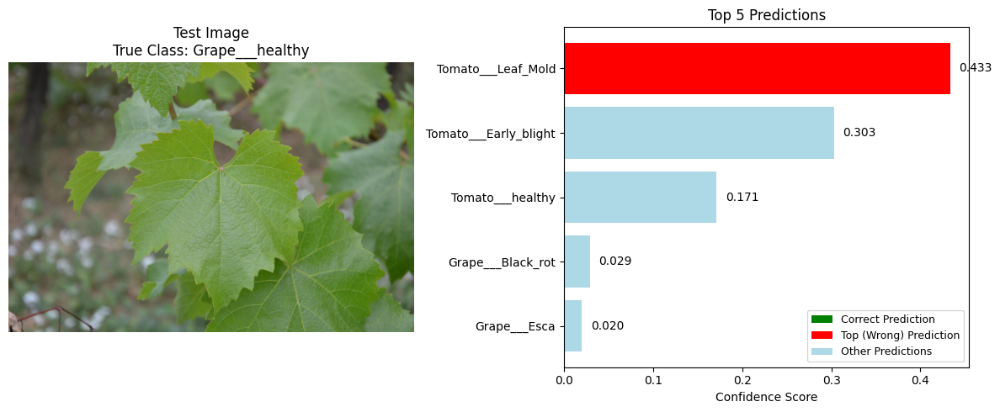

    Detailed predictions:
      1. Tomato___Leaf_Mold: 0.4331 ✗ (TOP PREDICTION - WRONG)
      2. Tomato___Early_blight: 0.3028
      3. Tomato___healthy: 0.1713
      4. Grape___Black_rot: 0.0293
      5. Grape___Esca: 0.0202

--- Image 2/2: Wild-Grape-Leaves-3.jpg ---
  ❌ Predicted: Tomato___healthy (confidence: 0.4585)
    True class: Grape___healthy


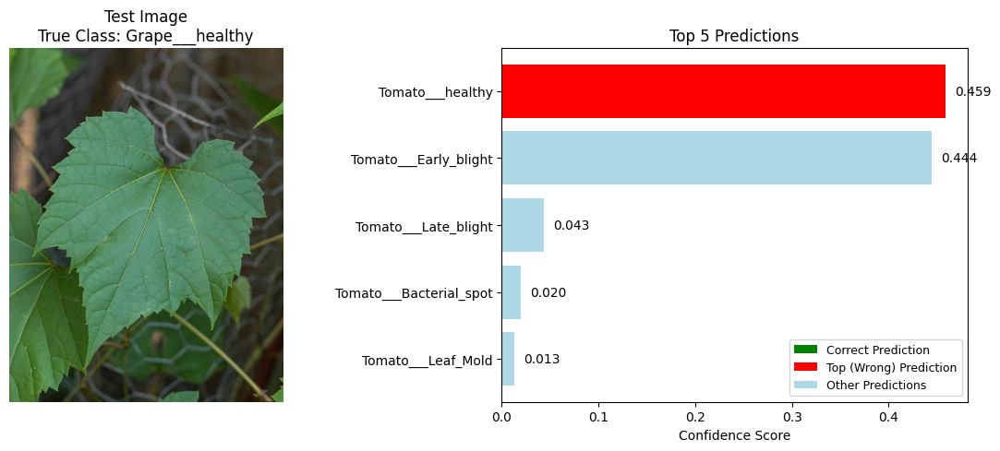

    Detailed predictions:
      1. Tomato___healthy: 0.4585 ✗ (TOP PREDICTION - WRONG)
      2. Tomato___Early_blight: 0.4444
      3. Tomato___Late_blight: 0.0432
      4. Tomato___Bacterial_spot: 0.0198
      5. Tomato___Leaf_Mold: 0.0127

Testing random images from class: Mango__Gall_Midge
Found 4 images in Mango__Gall_Midge
Randomly selected 3 images for testing

--- Image 1/3: 290506darnleyislewalterluimango5-galls-in-upper-leaf-surface.jpg ---
  ❌ Predicted: Corn__Common_Rust (confidence: 0.3417)
    True class: Mango__Gall_Midge


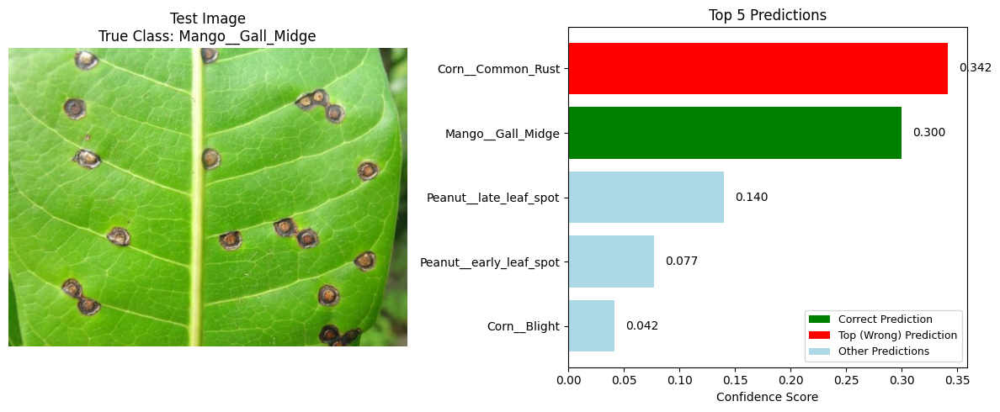

    Detailed predictions:
      1. Corn__Common_Rust: 0.3417 ✗ (TOP PREDICTION - WRONG)
      2. Mango__Gall_Midge: 0.2996 ✓ (CORRECT)
      3. Peanut__late_leaf_spot: 0.1398
      4. Peanut__early_leaf_spot: 0.0770
      5. Corn__Blight: 0.0417

--- Image 2/3: mango gall midge bb5180c7-d5ff-4efa-a926-107566c01ce2.jpg ---
  ✅ Predicted: Mango__Gall_Midge (confidence: 0.9182)
    True class: Mango__Gall_Midge


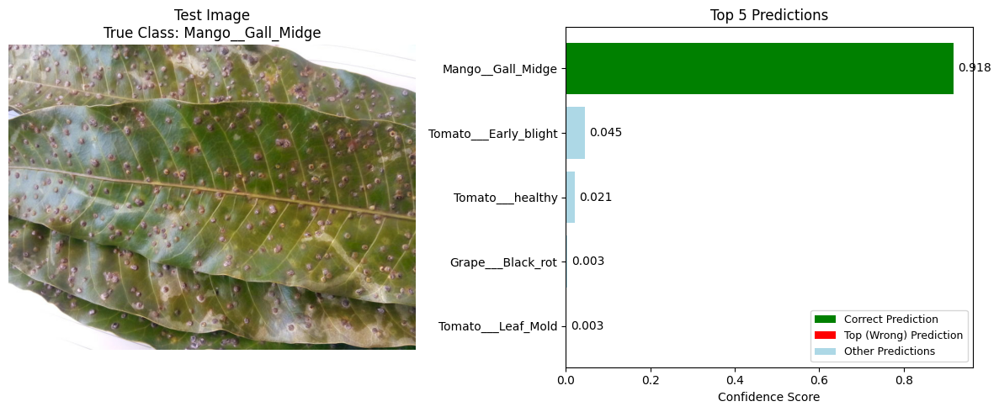

    Detailed predictions:
      1. Mango__Gall_Midge: 0.9182 ✓ (CORRECT)
      2. Tomato___Early_blight: 0.0451
      3. Tomato___healthy: 0.0215
      4. Grape___Black_rot: 0.0034
      5. Tomato___Leaf_Mold: 0.0025

--- Image 3/3: mango gall midge - charles mwaniki-89649f87-a0fa-46e5-b714-47fd4a60d6fa.jpg ---
  ❌ Predicted: Corn__Blight (confidence: 0.3459)
    True class: Mango__Gall_Midge


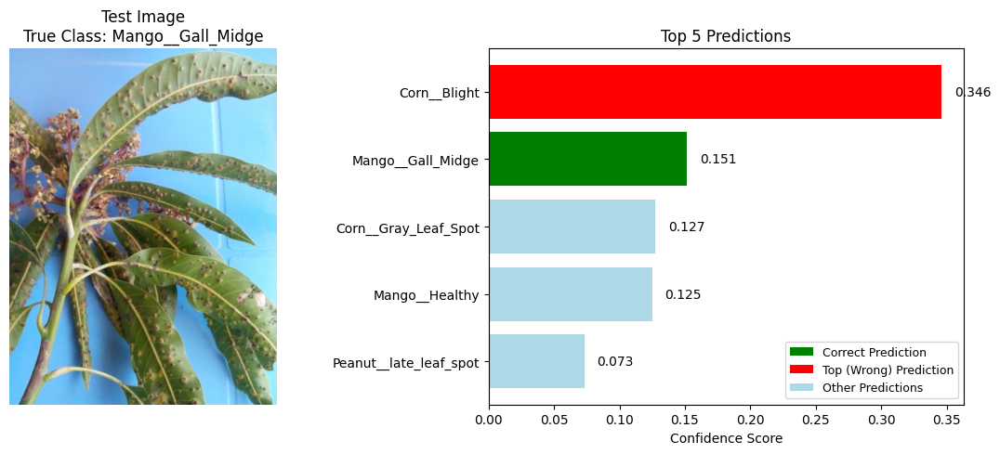

    Detailed predictions:
      1. Corn__Blight: 0.3459 ✗ (TOP PREDICTION - WRONG)
      2. Mango__Gall_Midge: 0.1515 ✓ (CORRECT)
      3. Corn__Gray_Leaf_Spot: 0.1271
      4. Mango__Healthy: 0.1248
      5. Peanut__late_leaf_spot: 0.0730

Testing random images from class: Mango__Healthy
Found 3 images in Mango__Healthy
Randomly selected 3 images for testing

--- Image 1/3: images.jpeg ---
  ❌ Predicted: Peanut__nutrition_deficiency (confidence: 0.9556)
    True class: Mango__Healthy


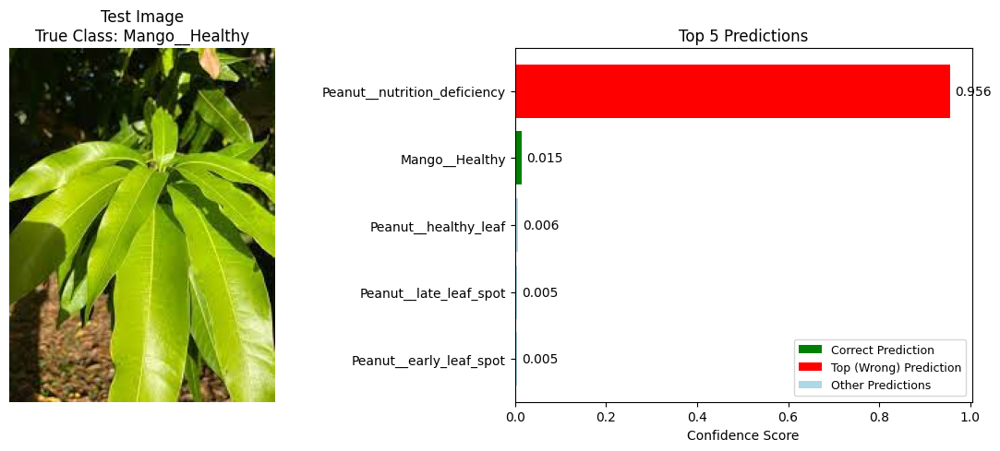

    Detailed predictions:
      1. Peanut__nutrition_deficiency: 0.9556 ✗ (TOP PREDICTION - WRONG)
      2. Mango__Healthy: 0.0151 ✓ (CORRECT)
      3. Peanut__healthy_leaf: 0.0062
      4. Peanut__late_leaf_spot: 0.0055
      5. Peanut__early_leaf_spot: 0.0049

--- Image 2/3: images (1).jpeg ---
  ❌ Predicted: Peanut__nutrition_deficiency (confidence: 0.8491)
    True class: Mango__Healthy


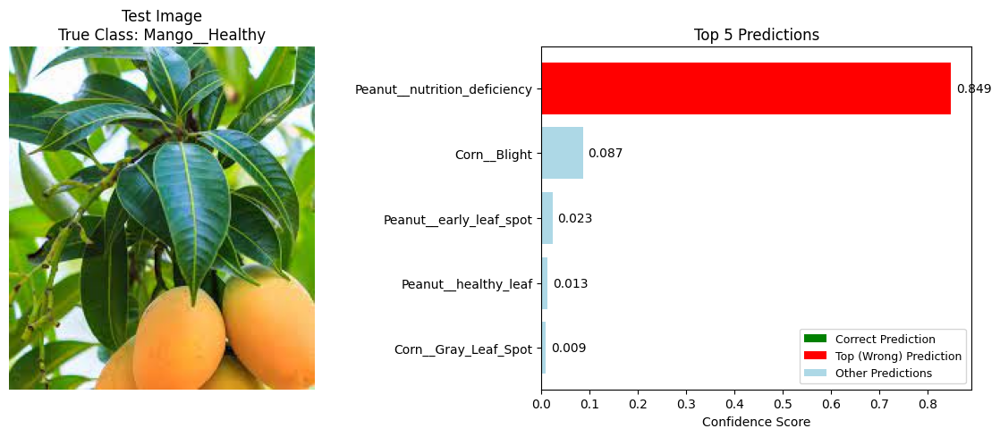

    Detailed predictions:
      1. Peanut__nutrition_deficiency: 0.8491 ✗ (TOP PREDICTION - WRONG)
      2. Corn__Blight: 0.0866
      3. Peanut__early_leaf_spot: 0.0229
      4. Peanut__healthy_leaf: 0.0131
      5. Corn__Gray_Leaf_Spot: 0.0094

--- Image 3/3: mango1.jpg ---
  ✅ Predicted: Mango__Healthy (confidence: 0.8581)
    True class: Mango__Healthy


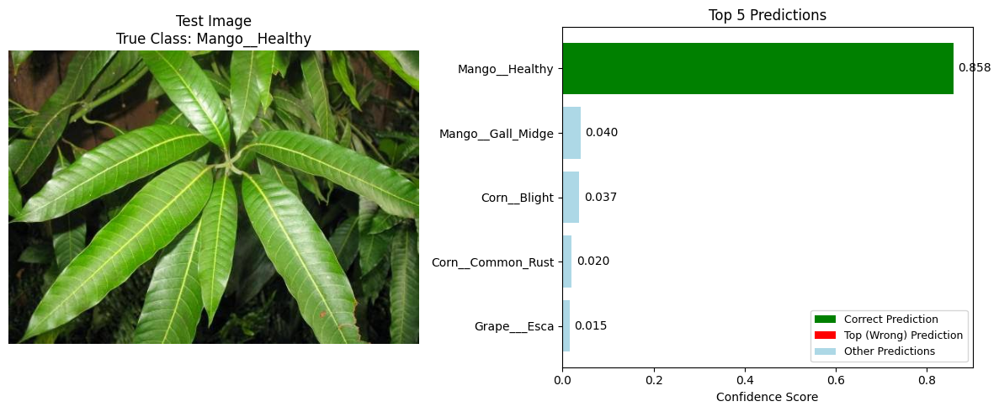

    Detailed predictions:
      1. Mango__Healthy: 0.8581 ✓ (CORRECT)
      2. Mango__Gall_Midge: 0.0401
      3. Corn__Blight: 0.0366
      4. Corn__Common_Rust: 0.0200
      5. Grape___Esca: 0.0152

Testing random images from class: Mango__Powdery_Mildew
Found 1 images in Mango__Powdery_Mildew
Randomly selected 1 images for testing

--- Image 1/1: 20211109_121410 (Custom).jpg ---
  ✅ Predicted: Mango__Powdery_Mildew (confidence: 0.9975)
    True class: Mango__Powdery_Mildew


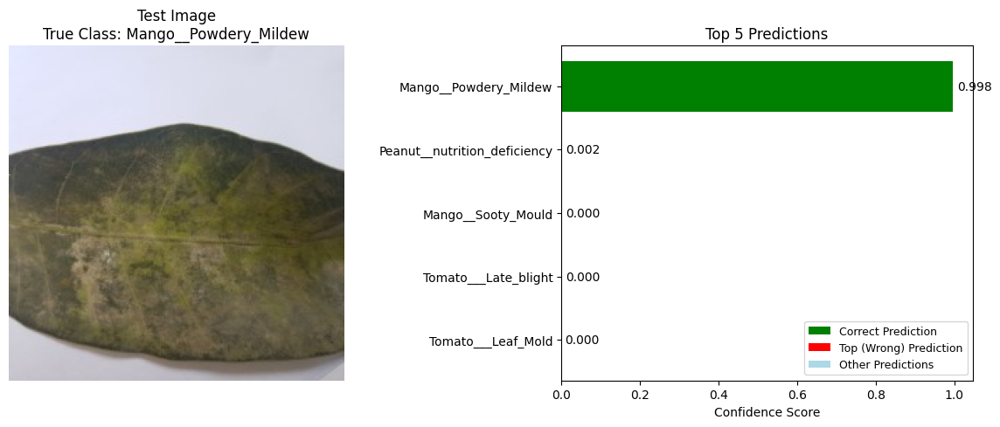

    Detailed predictions:
      1. Mango__Powdery_Mildew: 0.9975 ✓ (CORRECT)
      2. Peanut__nutrition_deficiency: 0.0021
      3. Mango__Sooty_Mould: 0.0002
      4. Tomato___Late_blight: 0.0001
      5. Tomato___Leaf_Mold: 0.0000

Testing random images from class: Peanut__early_leaf_spot
Found 2 images in Peanut__early_leaf_spot
Randomly selected 2 images for testing

--- Image 1/2: Groundnut_Early-leaf-spot_2.jpg ---
  ✅ Predicted: Peanut__early_leaf_spot (confidence: 0.9797)
    True class: Peanut__early_leaf_spot


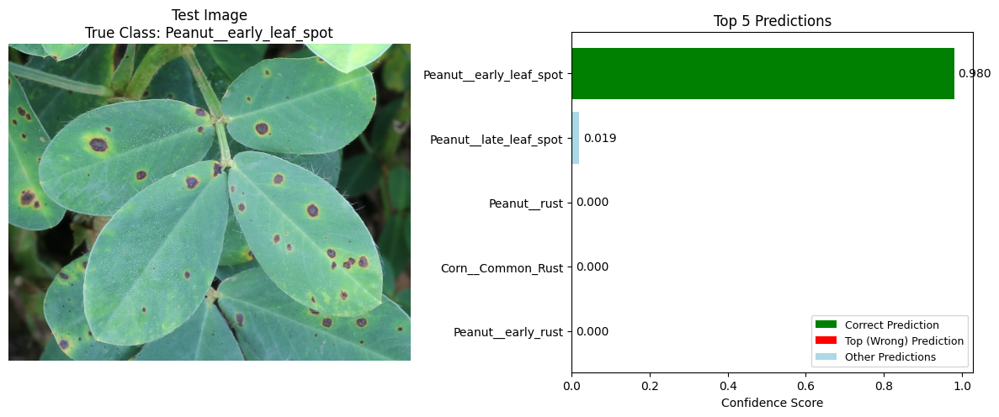

    Detailed predictions:
      1. Peanut__early_leaf_spot: 0.9797 ✓ (CORRECT)
      2. Peanut__late_leaf_spot: 0.0193
      3. Peanut__rust: 0.0003
      4. Corn__Common_Rust: 0.0003
      5. Peanut__early_rust: 0.0001

--- Image 2/2: PG-12-peanut-abiotic-leaf-spotting-provost-e1692988294544-637x551-1.jpg ---
  ❌ Predicted: Peanut__late_leaf_spot (confidence: 0.4366)
    True class: Peanut__early_leaf_spot


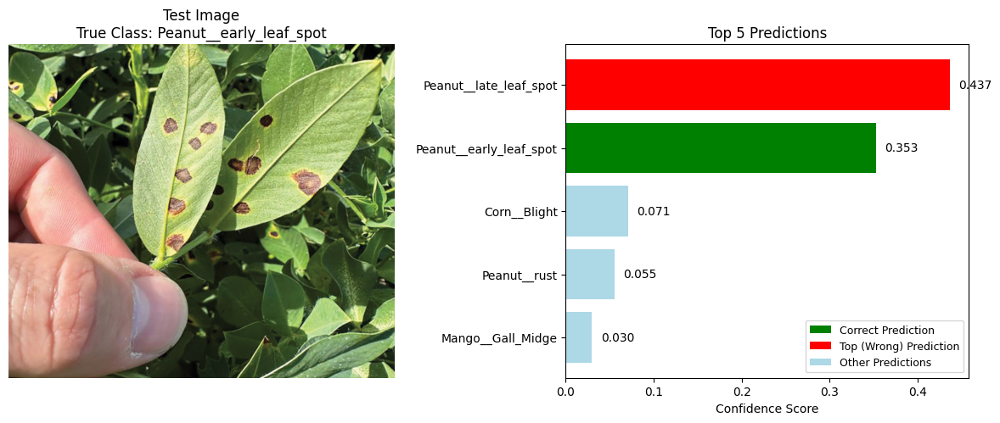

    Detailed predictions:
      1. Peanut__late_leaf_spot: 0.4366 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__early_leaf_spot: 0.3527 ✓ (CORRECT)
      3. Corn__Blight: 0.0708
      4. Peanut__rust: 0.0554
      5. Mango__Gall_Midge: 0.0299

Testing random images from class: Peanut__early_rust
Found 2 images in Peanut__early_rust
Randomly selected 2 images for testing

--- Image 1/2: images.jpeg ---
  ❌ Predicted: Peanut__rust (confidence: 0.7284)
    True class: Peanut__early_rust


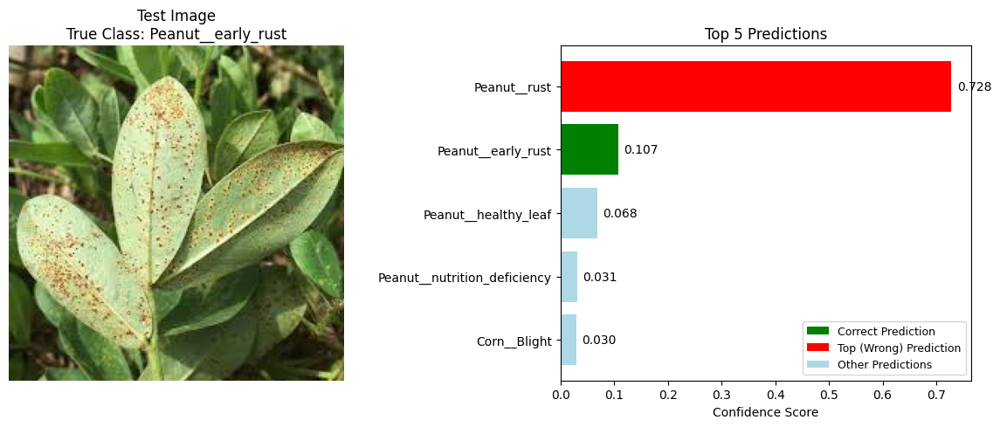

    Detailed predictions:
      1. Peanut__rust: 0.7284 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__early_rust: 0.1069 ✓ (CORRECT)
      3. Peanut__healthy_leaf: 0.0680
      4. Peanut__nutrition_deficiency: 0.0306
      5. Corn__Blight: 0.0297

--- Image 2/2: Peanut-Rust-blog-Image-1.png-225x300.jpg ---
  ❌ Predicted: Tomato___Early_blight (confidence: 0.3929)
    True class: Peanut__early_rust


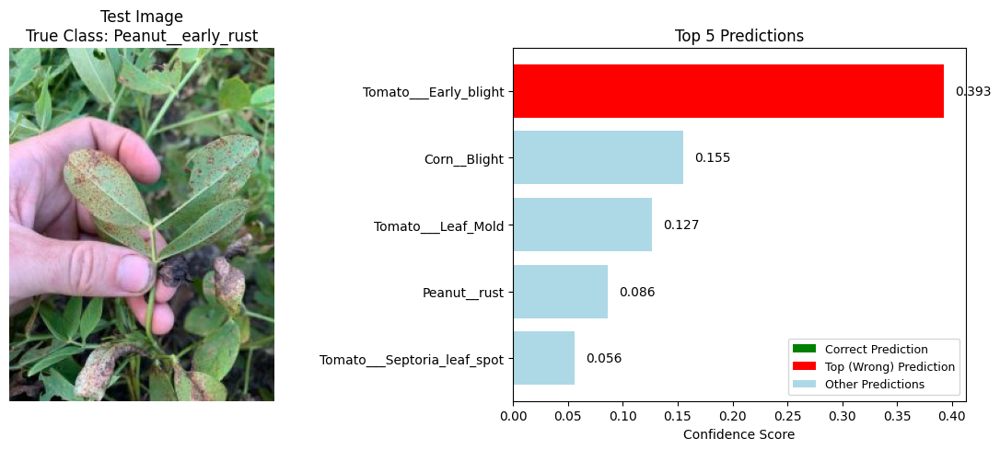

    Detailed predictions:
      1. Tomato___Early_blight: 0.3929 ✗ (TOP PREDICTION - WRONG)
      2. Corn__Blight: 0.1554
      3. Tomato___Leaf_Mold: 0.1268
      4. Peanut__rust: 0.0862
      5. Tomato___Septoria_leaf_spot: 0.0560

Testing random images from class: Peanut__healthy_leaf
Found 1 images in Peanut__healthy_leaf
Randomly selected 1 images for testing

--- Image 1/1: image_processing20220902-1323614-1fwtna3.jpg ---
  ❌ Predicted: Tomato___healthy (confidence: 0.3591)
    True class: Peanut__healthy_leaf


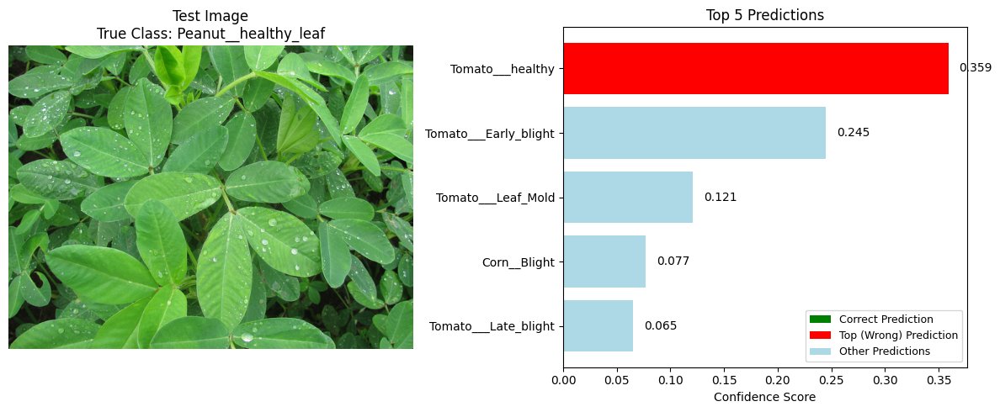

    Detailed predictions:
      1. Tomato___healthy: 0.3591 ✗ (TOP PREDICTION - WRONG)
      2. Tomato___Early_blight: 0.2448
      3. Tomato___Leaf_Mold: 0.1210
      4. Corn__Blight: 0.0770
      5. Tomato___Late_blight: 0.0653

Testing random images from class: Peanut__late_leaf_spot
Found 4 images in Peanut__late_leaf_spot
Randomly selected 3 images for testing

--- Image 1/3: 4.jpg ---
  ❌ Predicted: Peanut__rust (confidence: 0.6471)
    True class: Peanut__late_leaf_spot


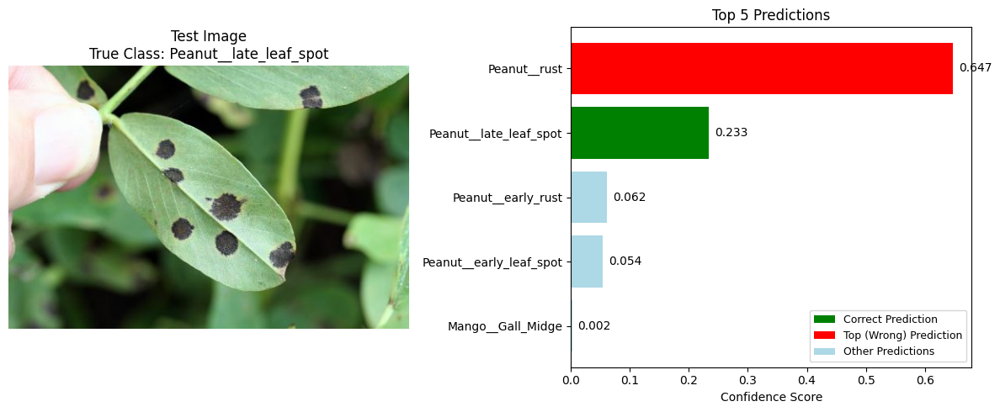

    Detailed predictions:
      1. Peanut__rust: 0.6471 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__late_leaf_spot: 0.2333 ✓ (CORRECT)
      3. Peanut__early_rust: 0.0619
      4. Peanut__early_leaf_spot: 0.0538
      5. Mango__Gall_Midge: 0.0021

--- Image 2/3: Groundnut_Early-leaf-spot_1.jpg ---
  ✅ Predicted: Peanut__late_leaf_spot (confidence: 0.8227)
    True class: Peanut__late_leaf_spot


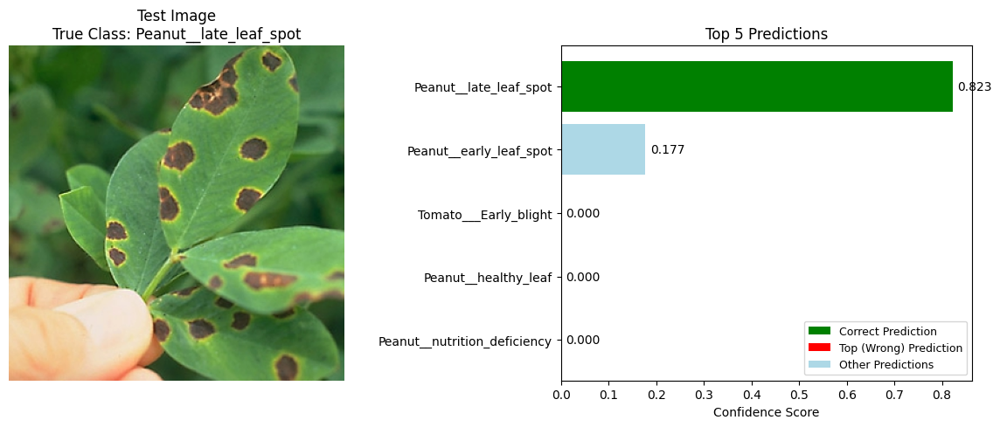

    Detailed predictions:
      1. Peanut__late_leaf_spot: 0.8227 ✓ (CORRECT)
      2. Peanut__early_leaf_spot: 0.1768
      3. Tomato___Early_blight: 0.0003
      4. Peanut__healthy_leaf: 0.0001
      5. Peanut__nutrition_deficiency: 0.0000

--- Image 3/3: images.jpeg ---
  ❌ Predicted: Tomato___Early_blight (confidence: 0.6284)
    True class: Peanut__late_leaf_spot


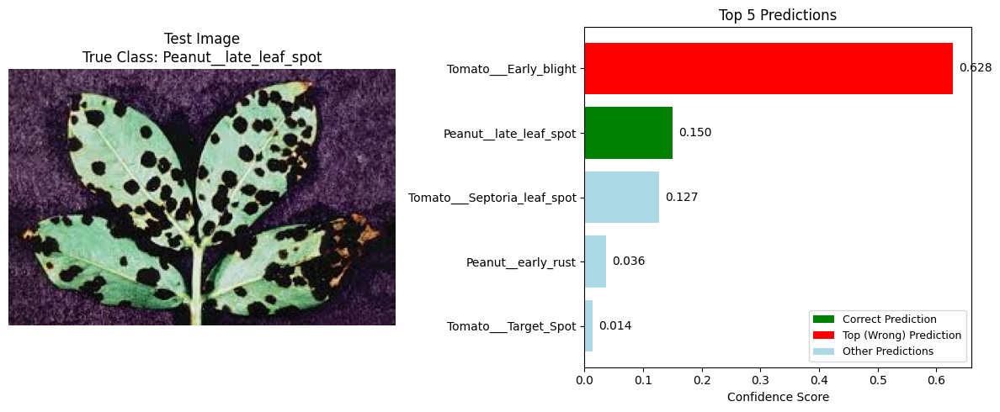

    Detailed predictions:
      1. Tomato___Early_blight: 0.6284 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__late_leaf_spot: 0.1498 ✓ (CORRECT)
      3. Tomato___Septoria_leaf_spot: 0.1267
      4. Peanut__early_rust: 0.0362
      5. Tomato___Target_Spot: 0.0138

Testing random images from class: Peanut__nutrition_deficiency
Found 2 images in Peanut__nutrition_deficiency
Randomly selected 2 images for testing

--- Image 1/2: images.jpeg ---
  ✅ Predicted: Peanut__nutrition_deficiency (confidence: 0.9958)
    True class: Peanut__nutrition_deficiency


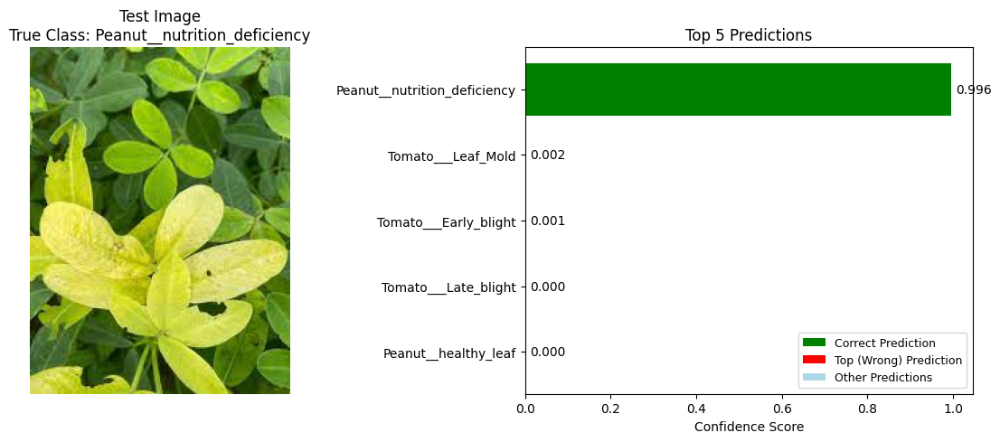

    Detailed predictions:
      1. Peanut__nutrition_deficiency: 0.9958 ✓ (CORRECT)
      2. Tomato___Leaf_Mold: 0.0016
      3. Tomato___Early_blight: 0.0009
      4. Tomato___Late_blight: 0.0005
      5. Peanut__healthy_leaf: 0.0004

--- Image 2/2: Iron-1-2.jpg ---
  ❌ Predicted: Peanut__rust (confidence: 0.5298)
    True class: Peanut__nutrition_deficiency


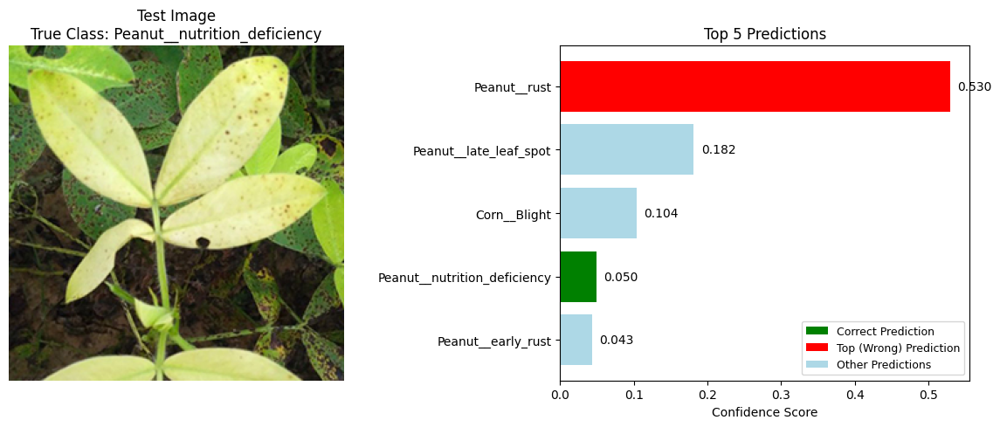

    Detailed predictions:
      1. Peanut__rust: 0.5298 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__late_leaf_spot: 0.1816
      3. Corn__Blight: 0.1037
      4. Peanut__nutrition_deficiency: 0.0495 ✓ (CORRECT)
      5. Peanut__early_rust: 0.0435

Testing random images from class: Peanut__rust
Found 4 images in Peanut__rust
Randomly selected 3 images for testing

--- Image 1/3: PG-12-13d-peanut-rust-pustules.jpg ---
  ❌ Predicted: Peanut__late_leaf_spot (confidence: 0.9236)
    True class: Peanut__rust


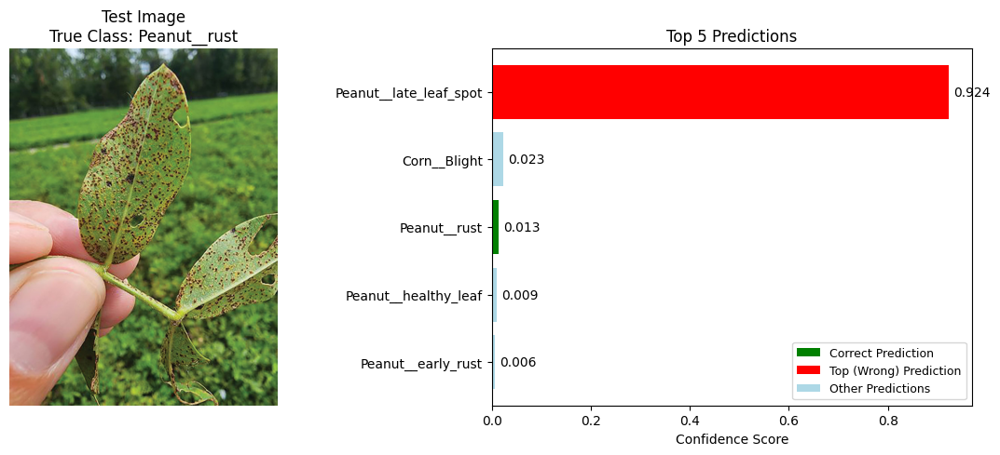

    Detailed predictions:
      1. Peanut__late_leaf_spot: 0.9236 ✗ (TOP PREDICTION - WRONG)
      2. Corn__Blight: 0.0227
      3. Peanut__rust: 0.0127 ✓ (CORRECT)
      4. Peanut__healthy_leaf: 0.0094
      5. Peanut__early_rust: 0.0055

--- Image 2/3: peanutrust.jpg ---
  ❌ Predicted: Peanut__late_leaf_spot (confidence: 0.4403)
    True class: Peanut__rust


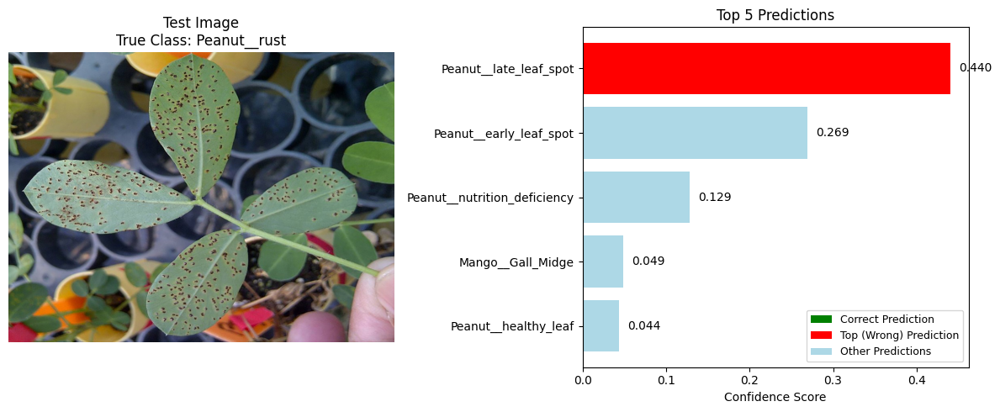

    Detailed predictions:
      1. Peanut__late_leaf_spot: 0.4403 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__early_leaf_spot: 0.2693
      3. Peanut__nutrition_deficiency: 0.1286
      4. Mango__Gall_Midge: 0.0486
      5. Peanut__healthy_leaf: 0.0441

--- Image 3/3: Groundnut_Rust_3.jpg ---
  ❌ Predicted: Peanut__late_leaf_spot (confidence: 0.9639)
    True class: Peanut__rust


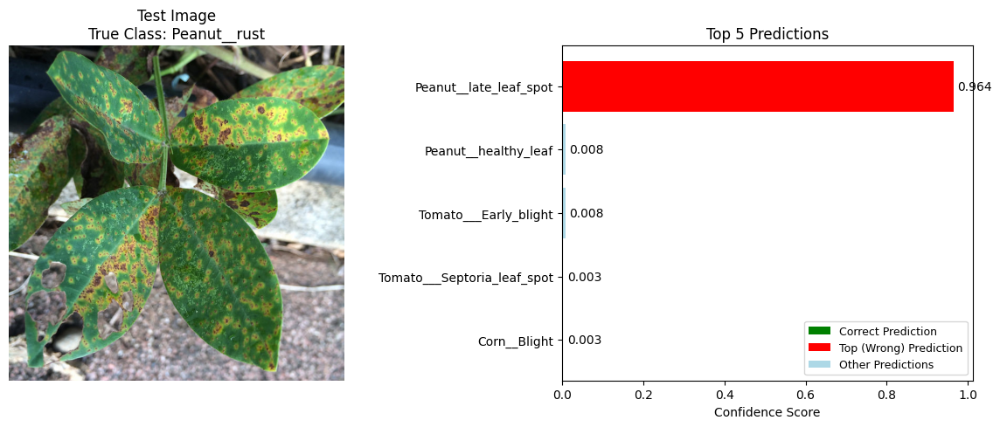

    Detailed predictions:
      1. Peanut__late_leaf_spot: 0.9639 ✗ (TOP PREDICTION - WRONG)
      2. Peanut__healthy_leaf: 0.0085
      3. Tomato___Early_blight: 0.0081
      4. Tomato___Septoria_leaf_spot: 0.0033
      5. Corn__Blight: 0.0032

🔍 COMPREHENSIVE CLASSIFICATION REPORT

📊 OVERALL PERFORMANCE:
   Total images tested: 35
   Correct predictions: 13
   Wrong predictions: 22
   Overall Accuracy: 0.371 (37.1%)

📈 PER-CLASS ACCURACY:
   Corn__Blight: 3/3 correct = 1.000 (100.0%)
   Corn__Common_Rust: 2/3 correct = 0.667 (66.7%)
   Corn__Gray_Leaf_Spot: No images tested
   Corn__Healthy: No images tested
   Grape___Black_rot: 1/3 correct = 0.333 (33.3%)
   Grape___Esca: 1/1 correct = 1.000 (100.0%)
   Grape___Leaf_blight: 0/3 correct = 0.000 (0.0%)
   Grape___healthy: 0/2 correct = 0.000 (0.0%)
   Mango__Gall_Midge: 1/3 correct = 0.333 (33.3%)
   Mango__Healthy: 1/3 correct = 0.333 (33.3%)
   Mango__Powdery_Mildew: 1/1 correct = 1.000 (100.0%)
   Mango__Sooty_Mould: No images tes

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_

In [28]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report

class ModelTester:
    def __init__(self, model_path, test_data_path, class_names=None):
        """
        Initialize the model tester

        Args:
            model_path: Path to .keras model file
            test_data_path: Path to folder containing subfolders with images
            class_names: List of class names (optional, will be inferred from folder names)
        """
        self.model_path = model_path
        self.test_data_path = test_data_path
        self.model = None
        self.class_names = class_names
        self.input_size = (224, 224)

    def load_model(self):
        """Load the trained model"""
        print(f"Loading model from {self.model_path}")
        self.model = tf.keras.models.load_model(self.model_path)
        print("Model loaded successfully!")
        print(f"Model input shape: {self.model.input_shape}")

    def get_class_names(self):
        """Get class names from folder structure"""
        if self.class_names is None:
            self.class_names = sorted([d for d in os.listdir(self.test_data_path)
                                     if os.path.isdir(os.path.join(self.test_data_path, d))])
        print(f"Found classes: {self.class_names}")
        return self.class_names

    def preprocess_image(self, image_path):
        try:
            # Load and resize image
            image = Image.open(image_path).convert('RGB')
            image = image.resize(self.input_size)

            # Convert to array and normalize
            image_array = np.array(image) / 255.0

            # Add batch dimension
            image_array = np.expand_dims(image_array, axis=0)

            return image_array
        except Exception as e:
            print(f"Error processing image {image_path}: {e}")
            return None

    def predict_single_image(self, image_path):
        processed_image = self.preprocess_image(image_path)
        if processed_image is None:
            return None, None

        # Get predictions
        predictions = self.model.predict(processed_image, verbose=0)
        predicted_class_idx = np.argmax(predictions[0])

        return predictions[0], predicted_class_idx

    def plot_top_predictions(self, predictions, image_path, true_class=None):
        """
        Plot top N predictions with confidence scores (N = min(5, number of classes))
        Shows TRUE predictions regardless of whether correct class appears or not
        """
        num_classes = len(self.class_names)
        # Show top N predictions, but don't exceed available classes
        top_n = min(5, num_classes)

        # Get top N predictions - this will show the ACTUAL top predictions
        top_indices = np.argsort(predictions)[-top_n:][::-1]
        top_probs = predictions[top_indices]
        top_classes = [self.class_names[i] for i in top_indices]

        # Create the plot
        plt.figure(figsize=(12, 5))

        # Plot the image
        plt.subplot(1, 2, 1)
        image = Image.open(image_path)
        plt.imshow(image)
        plt.axis('off')
        title = f"Test Image"
        if true_class:
            title += f"\nTrue Class: {true_class}"
        plt.title(title, fontsize=12)

        # Plot top N predictions
        plt.subplot(1, 2, 2)
        # Color bars: green if prediction matches true class, red if it's the wrong prediction, lightblue for others
        colors = []
        for i, class_name in enumerate(top_classes):
            if true_class and class_name == true_class:
                colors.append('green')  # Correct prediction
            elif i == 0:  # Top prediction but wrong
                colors.append('red')
            else:
                colors.append('lightblue')  # Other predictions

        bars = plt.barh(range(len(top_probs)), top_probs, color=colors)
        plt.yticks(range(len(top_probs)), top_classes)
        plt.xlabel('Confidence Score')
        plt.title(f'Top {top_n} Predictions')
        plt.gca().invert_yaxis()

        # Add confidence values on bars
        for i, (bar, prob) in enumerate(zip(bars, top_probs)):
            plt.text(bar.get_width() + 0.01, bar.get_y() + bar.get_height()/2,
                    f'{prob:.3f}', va='center', fontsize=10)

        # Add legend
        legend_elements = [
            plt.Rectangle((0,0),1,1, facecolor='green', label='Correct Prediction'),
            plt.Rectangle((0,0),1,1, facecolor='red', label='Top (Wrong) Prediction'),
            plt.Rectangle((0,0),1,1, facecolor='lightblue', label='Other Predictions')
        ]
        plt.legend(handles=legend_elements, loc='lower right', fontsize=9)

        plt.tight_layout()
        plt.show()

        # Print detailed prediction info
        print(f"    Detailed predictions:")
        for i, (class_name, prob) in enumerate(zip(top_classes, top_probs)):
            status = ""
            if true_class:
                if class_name == true_class:
                    status = " ✓ (CORRECT)"
                elif i == 0:
                    status = " ✗ (TOP PREDICTION - WRONG)"
            print(f"      {i+1}. {class_name}: {prob:.4f}{status}")

    def test_random_images(self, images_per_class=3):
        """Test random images from each class"""
        results = []
        np.random.seed(42)  # For reproducible results, remove if you want different random selection each time

        for class_name in self.class_names:
            class_path = os.path.join(self.test_data_path, class_name)
            if not os.path.exists(class_path):
                print(f"Warning: Class folder '{class_name}' not found!")
                continue

            print(f"\n{'='*60}")
            print(f"Testing random images from class: {class_name}")
            print(f"{'='*60}")

            # Get all image files
            image_files = [f for f in os.listdir(class_path)
                          if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]

            if not image_files:
                print(f"  No images found in {class_name}")
                continue

            print(f"Found {len(image_files)} images in {class_name}")

            # Randomly select images
            num_to_select = min(images_per_class, len(image_files))
            selected_images = np.random.choice(image_files, num_to_select, replace=False)
            print(f"Randomly selected {num_to_select} images for testing")

            for idx, image_file in enumerate(selected_images):
                print(f"\n--- Image {idx+1}/{num_to_select}: {image_file} ---")

                image_path = os.path.join(class_path, image_file)
                predictions, predicted_idx = self.predict_single_image(image_path)

                if predictions is not None:
                    predicted_class = self.class_names[predicted_idx]
                    confidence = predictions[predicted_idx]
                    is_correct = class_name == predicted_class

                    results.append({
                        'image_path': image_path,
                        'image_file': image_file,
                        'true_class': class_name,
                        'predicted_class': predicted_class,
                        'confidence': confidence,
                        'correct': is_correct
                    })

                    status_emoji = "✅" if is_correct else "❌"
                    print(f"  {status_emoji} Predicted: {predicted_class} (confidence: {confidence:.4f})")
                    print(f"    True class: {class_name}")

                    # Show top predictions for this image
                    self.plot_top_predictions(predictions, image_path, true_class=class_name)
                else:
                    print(f"  ❌ Failed to process image: {image_file}")

        return pd.DataFrame(results)

    def plot_confusion_matrix(self, results_df):
        """Plot confusion matrix"""
        if results_df.empty:
            print("No results to plot confusion matrix")
            return

        y_true = results_df['true_class']
        y_pred = results_df['predicted_class']

        cm = confusion_matrix(y_true, y_pred, labels=self.class_names)

        plt.figure(figsize=(10, 8))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                    xticklabels=self.class_names, yticklabels=self.class_names)
        plt.title('Confusion Matrix - Model Performance')
        plt.ylabel('True Label')
        plt.xlabel('Predicted Label')
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout()
        plt.show()

    def generate_report(self, results_df):
        """Generate comprehensive classification report"""
        if results_df.empty:
            print("No results to generate report")
            return

        print("\n" + "="*70)
        print("🔍 COMPREHENSIVE CLASSIFICATION REPORT")
        print("="*70)

        # Overall accuracy
        total_images = len(results_df)
        correct_predictions = results_df['correct'].sum()
        accuracy = results_df['correct'].mean()

        print(f"\n📊 OVERALL PERFORMANCE:")
        print(f"   Total images tested: {total_images}")
        print(f"   Correct predictions: {correct_predictions}")
        print(f"   Wrong predictions: {total_images - correct_predictions}")
        print(f"   Overall Accuracy: {accuracy:.3f} ({accuracy*100:.1f}%)")

        # Per-class accuracy
        print(f"\n📈 PER-CLASS ACCURACY:")
        class_stats = results_df.groupby('true_class').agg({
            'correct': ['count', 'sum', 'mean']
        }).round(3)

        for class_name in self.class_names:
            if class_name in class_stats.index:
                total = class_stats.loc[class_name, ('correct', 'count')]
                correct = class_stats.loc[class_name, ('correct', 'sum')]
                accuracy = class_stats.loc[class_name, ('correct', 'mean')]
                print(f"   {class_name}: {correct}/{total} correct = {accuracy:.3f} ({accuracy*100:.1f}%)")
            else:
                print(f"   {class_name}: No images tested")

        # Detailed classification report
        print(f"\n📋 DETAILED SKLEARN CLASSIFICATION REPORT:")
        print("-" * 50)
        print(classification_report(results_df['true_class'], results_df['predicted_class']))

        # Show some example wrong predictions
        wrong_predictions = results_df[~results_df['correct']]
        if not wrong_predictions.empty:
            print(f"\n❌ EXAMPLE WRONG PREDICTIONS:")
            print("-" * 50)
            for _, row in wrong_predictions.head(5).iterrows():
                print(f"   Image: {row['image_file']}")
                print(f"   True: {row['true_class']} → Predicted: {row['predicted_class']} (conf: {row['confidence']:.3f})")
                print()

def main():
    """Main function to run the model testing"""
    # Configure these paths according to your setup
    MODEL_PATH = "/content/plant_disease_mnv2_best_model.keras"  # Path to your trained model
    TEST_DATA_PATH = "/content/tester"   # Path to folder containing disease folders

    # Optional: Define class names explicitly (will be auto-detected if None)
    CLASS_NAMES = class_names

    try:
        # Initialize tester
        print("🚀 Initializing Model Tester...")
        tester = ModelTester(MODEL_PATH, TEST_DATA_PATH, class_names=CLASS_NAMES)

        # Load model and get class names
        tester.load_model()
        tester.get_class_names()

        print(f"\n🎯 Model will show top {min(5, len(tester.class_names))} predictions per image")
        print("🎲 Starting random image testing...")

        # Test random images (you can change images_per_class)
        results_df = tester.test_random_images(images_per_class=3)

        # Generate comprehensive report
        if not results_df.empty:
            tester.generate_report(results_df)

            # # Plot confusion matrix
            # print("\n📈 Generating confusion matrix...")
            # tester.plot_confusion_matrix(results_df)

            # Save results
            output_file = "random_test_results.csv"
            results_df.to_csv(output_file, index=False)
            print(f"\n💾 Results saved to {output_file}")

            print("\n✅ Testing completed successfully!")
        else:
            print("\n❌ No images were processed successfully. Please check your paths and image files.")

    except Exception as e:
        print(f"\n❌ Error occurred: {str(e)}")
        print("Please check your model path, test data path, and ensure all dependencies are installed.")

main()